In [1]:
! pip install torchinfo
! pip install huggingface_hub

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.8/294.8 kB 3.1 MB/s eta 0:00:00


# GAN Week 2

Цели:

* Разобраться с WGAN
* Разобраться с WGAN-GP
* Познакомиться с CycleGan

Содержание:

* WGAN
  * [Earth Mover Distance](#earth_move_distance)
  * [Расстояния Васерштейна лучше чем дивергенция JS & KL ](#wgan_js)
  * [Липшицева непрерывность](#lipshitz)
  * [Что нового](#new)
  * [Код](#code)
* WGAN-GP
* CycleGan
  * [Архитектура модели CycleGAN](#arc_cycle)
  * [код Generator'а](#cyclegan_gen_code)
  * [код Discriminator'а](#cyclegan_disc_code)
  * [Функции потерь](#cyclegan_disc_code)
  * [цикл обучения](#cyclegan_train)
  * [Дополнительно: модификации CycleGAN](#cyclegan_mod)

* Упражнения

Ссылки:

* Оригиналы статей - [UNET+CGan](https://arxiv.org/pdf/1611.07004.pdf), [CycleGan](https://arxiv.org/pdf/1703.10593.pdf)
* Примеры реализаций GAN - [раз](https://nn.labml.ai/gan/index.html) и [два](https://github.com/eriklindernoren/PyTorch-GAN)
* [Курс по ганам от Andew Ng](https://www.coursera.org/specializations/generative-adversarial-networks-gans)
* [ИТМО блог](https://neerc.ifmo.ru/wiki/index.php?title=%D0%97%D0%B0%D0%B4%D0%B0%D1%87%D0%B0_%D1%82%D1%80%D0%B0%D0%BD%D1%81%D0%BB%D1%8F%D1%86%D0%B8%D0%B8_%D0%B8%D0%B7%D0%BE%D0%B1%D1%80%D0%B0%D0%B6%D0%B5%D0%BD%D0%B8%D0%B9)


##  WGAN

### Earth Mover Distance

Wasserstein GAN (WGAN) предлагает новую функцию потерь, использующую расстояние Вассерштейна, которая имеет более плавный градиент везде.

Расстояние Вассерштейна - это мера расстояния между двумя вероятностными распределениями. Его также называют расстоянием **Earth Mover’s distance**, сокращенно EM distance, поскольку неформально его можно интерпретировать как минимальные энергетические затраты на перемещение и преобразование кучи земли, имеющей форму одного распределения вероятностей, в форму другого распределения. Количественно затраты определяются следующим образом: количество перемещаемого грунта x расстояние перемещения.

Рассмотрим сначала простой случай, когда область вероятности дискретна. Например, предположим, что у нас есть два распределения $P$ и $Q$, каждое из которых содержит четыре кучи земли, а всего в обеих кучах по десять лопат земли. Количество лопат в каждой куче земли распределяется следующим образом:

$P_1 = 3,P_2 = 2, P_3 = 1, P_4 = 4, Q_1 = 1, Q_2 = 2, Q_3 = 4,  Q_4 = 3$

Для того чтобы изменить  P на Q, как показано на рисунке, необходимо:

1. переместить 2 полные лопаты с $P_1$ на $P_2$ => $(P_1,Q_1)$ совпадают.
2. переместить 2 полные лопаты с $P_2$ на $P_3$ => $(P_2,Q_2)$ совпадают.
3. переместить 1 полные лопату с $Q_3$ на $Q_4$ => $(P_3,Q_3)$ и $(P_4,Q_4)$ совпадают.

Если обозначить стоимость производства $P_i$ и соответствия $Q_i$ как $\delta_i$ , то $\delta_{i+1}=\delta_i+P_i-Q_i$, то получим:

$\delta_0 = 0$

$\delta_1 = 0 + 3 - 1 = 2$

$\delta_2 = 2 + 2 - 2 = 2$

$\delta_3 = 2 + 1 - 4 = -1$

$\delta_4 = -1 + 4 - 3 = 0$

Earth Mover's Distance: $W = \sum|{\delta_i}|$ = 5

<figure>
<img src="https://lilianweng.github.io/posts/2017-08-20-gan/EM_distance_discrete.png" alt="Forward vs Reverse KL" style="width:100%">
<figcaption align = "center"> Image credit: <a href="https://lilianweng.github.io/posts/2017-08-20-gan/">Eric Jang's blog</a></figcaption>
</figure>


Когда мы имеем дела с непрерывной вероятностной областью формула расстояния приобретает вид:

$W (P_r , P_g ) = \underset{γ∈Π(P_r ,P_g )}{inf} E_{(x,y)∼γ}[ ‖x − y‖ ]$

В приведенной формуле $Π(P_r ,P_g )$ - это множество всех возможных совместных распределений вероятностей между $p_r$ и $p_g$ . Одно совместное распределение $γ∈Π(P_r ,P_g )$ описывает один план перевозки земли, как в дискретном примере, так и в непрерывном вероятностном пространстве.

Именно $γ(x,y)$ определяет, какой процент земли нужно переместить из точки ${x}$ в ${y}$, чтобы ${x}$ соответствовало тому же распределению вероятностей, что и ${y}$. Поэтому предельное распределение ${x}$ в сумме равно ${p_g}$, $\sum_xγ(x,y)=p_g(y)$ (Закончив перемещение запланированного количества земли из всех возможных ${x}$ к цели ${y}$, мы получим ровно столько, сколько ${y}$ имеет согласно $p_g$) и наоборот $\sum_yγ(x,y)=p_r(x)$.

Если рассматривать ${x}$ как начальную точку ${y}$ и как конечный пункт, то общее количество перемещаемого грунта составляет $γ(x,y)$, расстояние в пути - $|x - y|$, и, следовательно, стоимость составляет $γ(x,y)\times |x-y|$. Ожидаемая стоимость, усредненная по всем парам $(x,y)$, может быть вычислена как:

$\sum_{x,y} γ(x,y) ||x-y|| = E_{(x,y)∼γ}‖x − y‖$

Наконец, в качестве расстояния EM мы берем минимальное среди затрат всех решений по перемещению земли. В определении расстояния Вассерштейна inf(infimum, также известное как наибольшая нижняя граница) указывает на то, что нас интересует только наименьшая стоимость.

### Расстояния Васерштейна лучше чем дивергенция JS & KL 


- Задача обучения автоэнкодеров сводится к задаче минимизации расстояния KL между распределением реальных и сгенерированных данных
- Задача обучения генертора сводится к задаче минимации расстояния JS между распределением реальных и сгенерированных данных

М. Аржовский провел полномасштабные исследования различных функций расстояния, таких как расстояние Кульбака-Лейблера, Дженсена-Шэннона, Вассерштейна, и показал на примере, что все они, за исключением расстояния Вассерштейна, в определенных случаях не приведут к сходимости распределения генератора к распределению данных.

<figure>
<img src="https://lilianweng.github.io/posts/2017-08-20-gan/wasserstein_simple_example.png" alt="Forward vs Reverse KL" style="width:100%">
<figcaption align = "center"> Image credit: <a href="https://lilianweng.github.io/posts/2017-08-20-gan/">Eric Jang's blog</a></figcaption>
</figure>


Предположим, что мы имеем два распределения вероятностей $P$ и $Q$:
$\forall (x, y) \in P, x = 0  {\ and } y \sim U(0, 1)\\  \forall (x, y) \in Q, x = \theta, 0 \leq \theta \leq 1 \ { \ and } y \sim U(0, 1)$


Когда $\theta \neq 0$


$\begin{aligned}
D_{KL}(P \| Q) &= \sum_{x=0, y \sim U(0, 1)} 1 \cdot \log\frac{1}{0} = +\infty \\
D_{KL}(Q \| P) &= \sum_{x=\theta, y \sim U(0, 1)} 1 \cdot \log\frac{1}{0} = +\infty \\
D_{JS}(P, Q) &= \frac{1}{2}(\sum_{x=0, y \sim U(0, 1)} 1 \cdot \log\frac{1}{1/2} + \sum_{x=0, y \sim U(0, 1)} 1 \cdot \log\frac{1}{1/2}) = \log 2\\
W(P, Q) &= |\theta|
\end{aligned}$

Когда $\theta = 0$

$\begin{aligned}
D_{KL}(P \| Q) &= D_{KL}(Q \| P) = D_{JS}(P, Q) = 0\\
W(P, Q) &= 0 = \lvert \theta \rvert
\end{aligned}$

KL дивергенция дает нам бесконечность когда у нас непересекающиеся распределения. JS дивергенция недифферинцируема в 0. Только метрика Вассерштейна дает гладкую меру, что очень полезно для стабильного процесса обучения с использованием градиентного спуска.

![wloss](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/WLOSS.png)

Согласно теореме двойственности Канторовича-Рубинштейна расстояние Васерштейна можно переписать в виде:
$\displaystyle W(p_r, p_g) = \frac{1}{K} \sup_{\| f \|_L \leq K} \mathbb{E}_{x \sim p_r}[f(x)] - \mathbb{E}_{x \sim p_g}[f(x)]$

### Липшицева непрерывность

Требуется, чтобы функция $f$ в новой форме метрики Вассерштейна удовлетворяла условию $|f|_L<=K$, то есть была K-липшицевой непрерывной. Вещественная функция $f: \mathbb R-> \mathbb R$ называется непрерывной по Липшицу, если существует вещественная константа K>=0, такая, что для всех $x1,x2 ∈ \mathbb R$,

$|f(x_1) - f(x_2)| <= K|x_1 - x_2|$

![Lip_gif](https://upload.wikimedia.org/wikipedia/commons/thumb/5/58/Lipschitz_Visualisierung.gif/523px-Lipschitz_Visualisierung.gif)

Одна из главных проблем - сохранить непрерывность K-Липшица в процессе обучения. В статье представлен простой, но очень практичный прием: После каждого обновления градиента зажимаем веса $w$ в маленькое окно, например [-0.01, 0.01], в результате чего получаем компактное пространство параметров $W$ и, таким образом $f_w$, получаем его нижнюю и верхнюю границы для сохранения непрерывности Липшица.

![wloss](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/wgan_vs_gan.png)

*Дискриминатор уже не является прямым критерием отличия реальных изображений от нереальных. Вместо этого он обучается непрерывной функции - K-Липшица, которая помогает вычислить расстояние Васерштейна. По мере обучения функция потерь уменьшается, расстояние Васерштейна становится меньше, а выход генераторной модели приближается к реальному распределению данных.*

### Что нового
1. Функция потерь BCE держит выход в диапазоне [0, 1]. Отказались от нее. Используется новая функция потерь, полученная из расстояния Вассерштейна, без логарифма. Модель "дискриминатор" играет роль не прямого критика, а помощника для оценки метрики Вассерштейна между реальным и сгенерированным распределением данных.
2. После каждого обновления градиента  зажимаем веса критика (раньше был дискриминатор) в небольшом фиксированном диапазоне, [-c, c] .
3. Авторы рекомендовали оптимизатор RMSProp на критике, а не оптимизатор на основе импульса, такой как Adam, который может привести к нестабильности в обучении модели. (В следующих вариациях вернулись к Adam)

### Код

In [2]:
import numpy as np
import math
import torchvision.transforms as transforms

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch
from torchvision.utils import save_image
from torchinfo import summary
import torch.autograd as autograd
import pandas as pd
from torch.utils.data import Dataset
from torchvision.datasets import MNIST
# Visualize result
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from torch.autograd import grad as torch_grad

In [ ]:
channels = 1 # suggested default : 1, number of image channels (gray scale)
img_size = 28 # suggested default : 28, size of each image dimension
img_shape = (channels, img_size, img_size) # (Channels, Image Size(H), Image Size(W))
latent_dim = 100 # suggested default. dimensionality of the latent space
sample_interval = 200
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cuda = torch.cuda.is_available()
n_classes = 10

In [ ]:
# TODO: Сделать единую функцию display_images

def display_images(in_, out, row_count = 4, n=1, epoch=0, iteration=0):
    """Displaying routine"""
    for N in range(n):
        if in_ is not None:
            in_pic = to_img(in_.cpu().data)
            plt.figure(figsize=(12, 4))
            for i in range(row_count):
                plt.subplot(1,row_count,i+1)
                plt.imshow(in_pic[i+row_count*N])
                plt.axis('off')
        out_pic = to_img(out.cpu().data)
        plt.figure(figsize=(12, 4))
        if iteration != 0:
            plt.suptitle('EPOCH : {} | BATCH(ITERATION) : {}'.format(epoch+1, iteration+1))
        for i in range(row_count):
            plt.subplot(1,row_count,i+1)
            plt.imshow(out_pic[i+row_count*N])
            plt.axis('off')
        plt.show()

def to_img(y):
    """Convert vector to image"""
    y = 0.5 * (y + 1)
    y = y.view(y.size(0), 28, 28)
    return y


def set_default(figsize=(10, 10), dpi=100):
    plt.style.use(['dark_background', 'bmh'])
    plt.rc('axes', facecolor='k')
    plt.rc('figure', facecolor='k')
    plt.rc('figure', figsize=figsize, dpi=dpi)


set_default(figsize=(12, 3))

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.init_size = img_size // 4
        self.l1 = nn.Sequential(nn.Linear(latent_dim, 128 * self.init_size ** 2))

        self.conv_blocks = nn.Sequential(
            nn.BatchNorm2d(128),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 128, 3, stride=1, padding=1),
            nn.BatchNorm2d(128, 0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 64, 3, stride=1, padding=1),
            nn.BatchNorm2d(64, 0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, channels, 3, stride=1, padding=1),
            nn.Tanh(),
        )

    def forward(self, z):
        out = self.l1(z)
        out = out.view(out.shape[0], 128, self.init_size, self.init_size)
        img = self.conv_blocks(out)
        return img

summary(Generator().to("cpu"), (1, 100))

Layer (type:depth-idx)                   Output Shape              Param #
Generator                                [1, 1, 28, 28]            --
├─Sequential: 1-1                        [1, 6272]                 --
│    └─Linear: 2-1                       [1, 6272]                 633,472
├─Sequential: 1-2                        [1, 1, 28, 28]            --
│    └─BatchNorm2d: 2-2                  [1, 128, 7, 7]            256
│    └─Upsample: 2-3                     [1, 128, 14, 14]          --
│    └─Conv2d: 2-4                       [1, 128, 14, 14]          147,584
│    └─BatchNorm2d: 2-5                  [1, 128, 14, 14]          256
│    └─LeakyReLU: 2-6                    [1, 128, 14, 14]          --
│    └─Upsample: 2-7                     [1, 128, 28, 28]          --
│    └─Conv2d: 2-8                       [1, 64, 28, 28]           73,792
│    └─BatchNorm2d: 2-9                  [1, 64, 28, 28]           128
│    └─LeakyReLU: 2-10                   [1, 64, 28, 28]           -

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        def discriminator_block(in_filters, out_filters):
            block = [
                nn.Conv2d(in_filters, out_filters, 4, 2, 0),
                nn.BatchNorm2d(out_filters),
                nn.LeakyReLU(0.2, inplace=True)
                ]
            return block

        self.model = nn.Sequential(
            *discriminator_block(channels, 64),
            *discriminator_block(64, 128),
        )
        self.adv_layer = nn.Sequential(
                nn.Conv2d(128, 1, 4, 2, 0),
            )

    def forward(self, img):
        out = self.model(img)
        validity = self.adv_layer(out)

        return validity

summary(Discriminator().to("cpu") , (1, 1, 28, 28))

Layer (type:depth-idx)                   Output Shape              Param #
Discriminator                            [1, 1, 1, 1]              --
├─Sequential: 1-1                        [1, 128, 5, 5]            --
│    └─Conv2d: 2-1                       [1, 64, 13, 13]           1,088
│    └─BatchNorm2d: 2-2                  [1, 64, 13, 13]           128
│    └─LeakyReLU: 2-3                    [1, 64, 13, 13]           --
│    └─Conv2d: 2-4                       [1, 128, 5, 5]            131,200
│    └─BatchNorm2d: 2-5                  [1, 128, 5, 5]            256
│    └─LeakyReLU: 2-6                    [1, 128, 5, 5]            --
├─Sequential: 1-2                        [1, 1, 1, 1]              --
│    └─Conv2d: 2-7                       [1, 1, 1, 1]              2,049
Total params: 134,721
Trainable params: 134,721
Non-trainable params: 0
Total mult-adds (M): 3.47
Input size (MB): 0.00
Forward/backward pass size (MB): 0.22
Params size (MB): 0.54
Estimated Total Size (MB): 0.77

In [ ]:
generator = Generator()
discriminator = Discriminator()

In [ ]:
generator

Generator(
  (l1): Sequential(
    (0): Linear(in_features=100, out_features=6272, bias=True)
  )
  (conv_blocks): Sequential(
    (0): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): Upsample(scale_factor=2.0, mode='nearest')
    (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): BatchNorm2d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Upsample(scale_factor=2.0, mode='nearest')
    (6): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): BatchNorm2d(64, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): Tanh()
  )
)

In [ ]:
discriminator

Discriminator(
  (model): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (adv_layer): Sequential(
    (0): Conv2d(128, 1, kernel_size=(4, 4), stride=(2, 2))
  )
)

In [ ]:
if cuda:
    generator.cuda()
    discriminator.cuda()

In [ ]:
batch_size = 256

img_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # to scale images from [0, 1] to [-1, -1]
])

dataset = MNIST('./data', transform=img_transform, download=True)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

100%|██████████| 9912422/9912422 [00:00<00:00, 150290313.79it/s]

Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw


100%|██████████| 28881/28881 [00:00<00:00, 93324879.68it/s]


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 37199811.72it/s]


Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 18424109.06it/s]

Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw



In [ ]:
# suggested default - learning rate
lr = 5e-5
beta_1 = 0.5
beta_2 = 0.999
clip_value = 0.01
n_critic = 5
n_epochs = 50 # suggested default = 200

In [ ]:
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta_1, beta_2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta_1, beta_2))
Tensor = torch.cuda.FloatTensor if cuda else torch.FloatTensor

  0%|          | 0/235 [00:00<?, ?it/s]

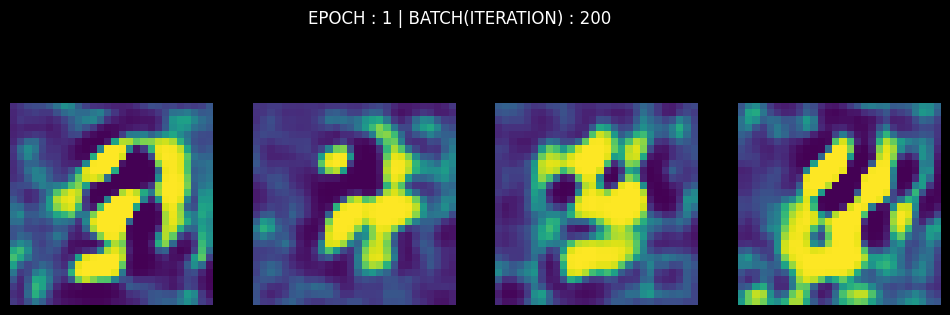

[Epoch: 1/50] [Batch: 235/235] [D loss: -0.005196] [G loss: -0.007643]


  0%|          | 0/235 [00:00<?, ?it/s]

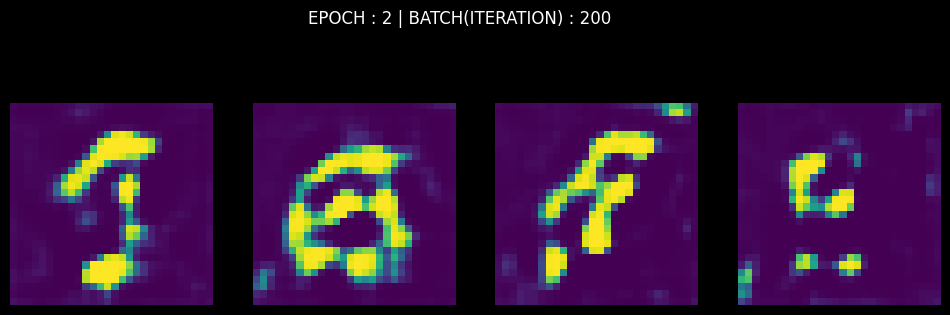

[Epoch: 2/50] [Batch: 235/235] [D loss: -0.005166] [G loss: 0.005635]


  0%|          | 0/235 [00:00<?, ?it/s]

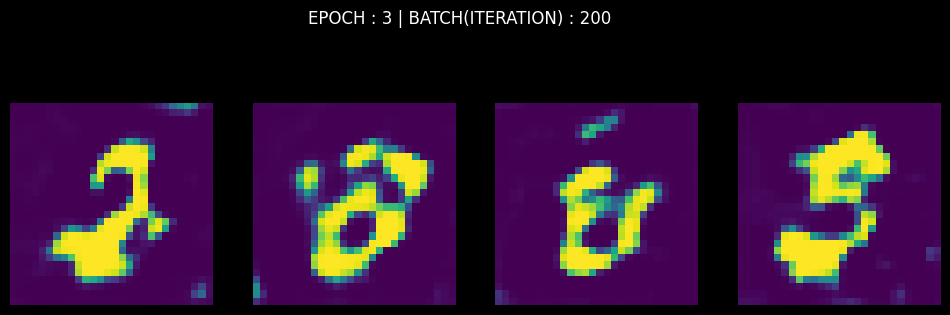

[Epoch: 3/50] [Batch: 235/235] [D loss: -0.005100] [G loss: -0.008863]


  0%|          | 0/235 [00:00<?, ?it/s]

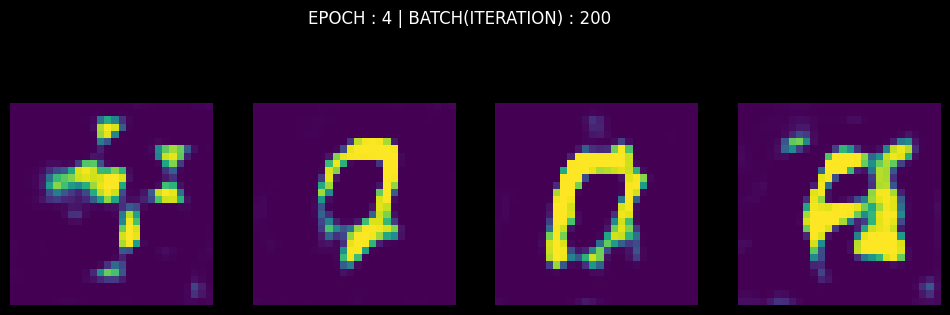

[Epoch: 4/50] [Batch: 235/235] [D loss: -0.004627] [G loss: 0.005207]


  0%|          | 0/235 [00:00<?, ?it/s]

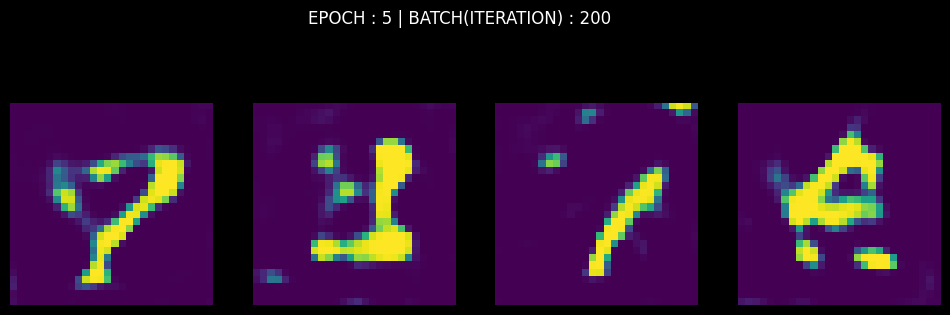

[Epoch: 5/50] [Batch: 235/235] [D loss: -0.004608] [G loss: 0.005326]


  0%|          | 0/235 [00:00<?, ?it/s]

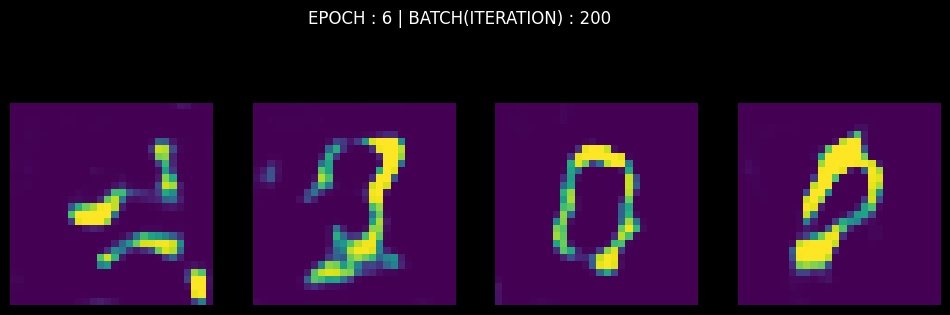

[Epoch: 6/50] [Batch: 235/235] [D loss: -0.004961] [G loss: -0.026984]


  0%|          | 0/235 [00:00<?, ?it/s]

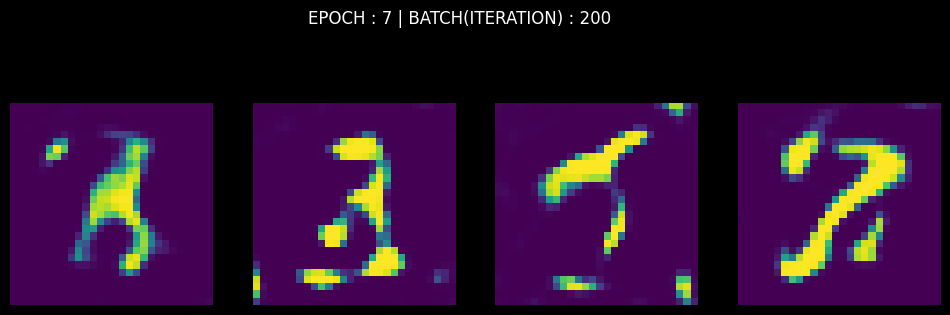

[Epoch: 7/50] [Batch: 235/235] [D loss: -0.004005] [G loss: -0.006480]


  0%|          | 0/235 [00:00<?, ?it/s]

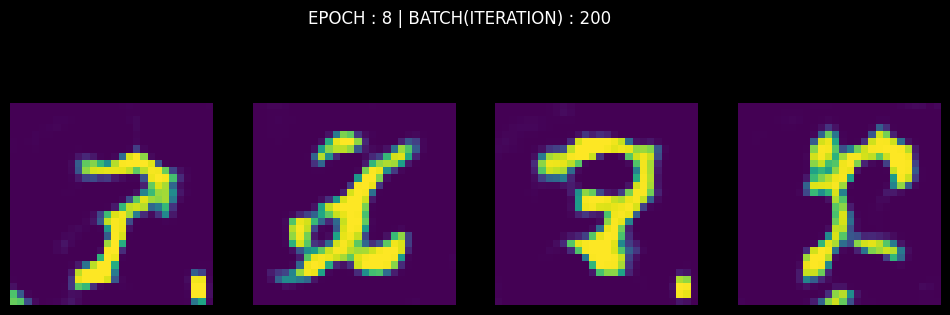

[Epoch: 8/50] [Batch: 235/235] [D loss: -0.003925] [G loss: 0.006537]


  0%|          | 0/235 [00:00<?, ?it/s]

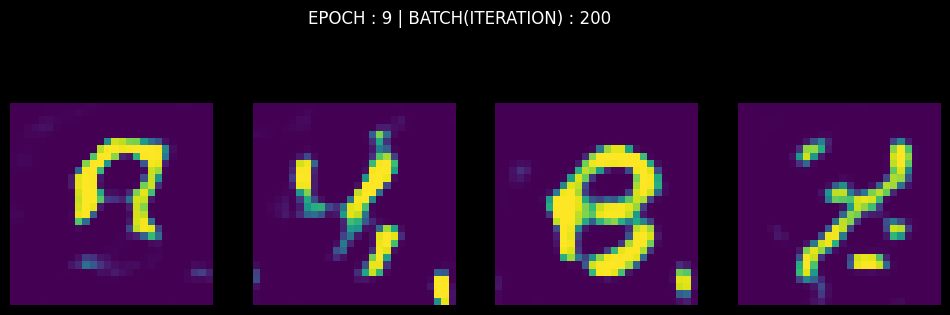

[Epoch: 9/50] [Batch: 235/235] [D loss: -0.003155] [G loss: -0.016985]


  0%|          | 0/235 [00:00<?, ?it/s]

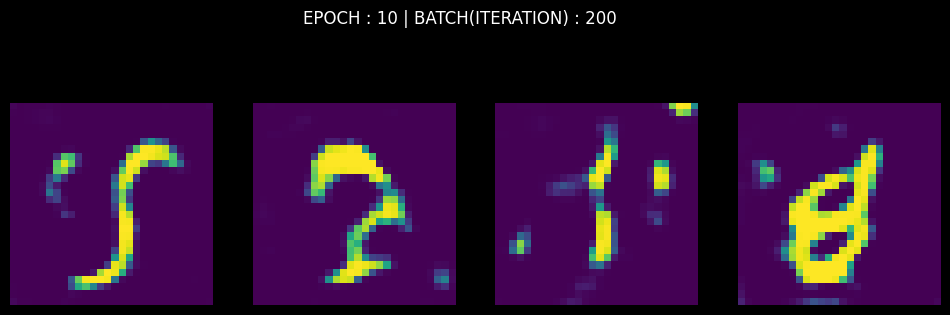

[Epoch: 10/50] [Batch: 235/235] [D loss: -0.003594] [G loss: -0.000007]


  0%|          | 0/235 [00:00<?, ?it/s]

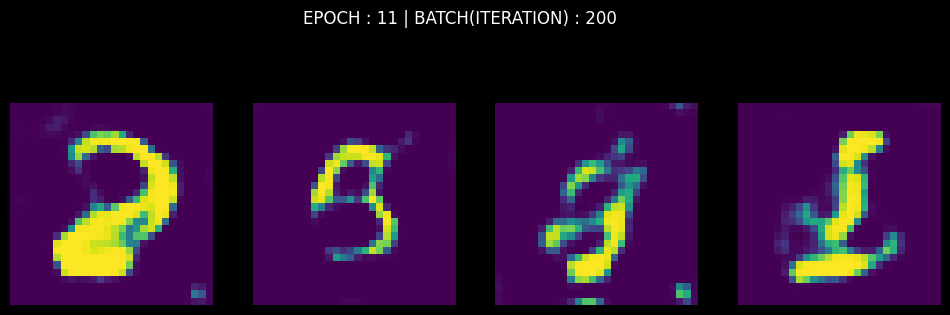

[Epoch: 11/50] [Batch: 235/235] [D loss: -0.003179] [G loss: 0.017177]


  0%|          | 0/235 [00:00<?, ?it/s]

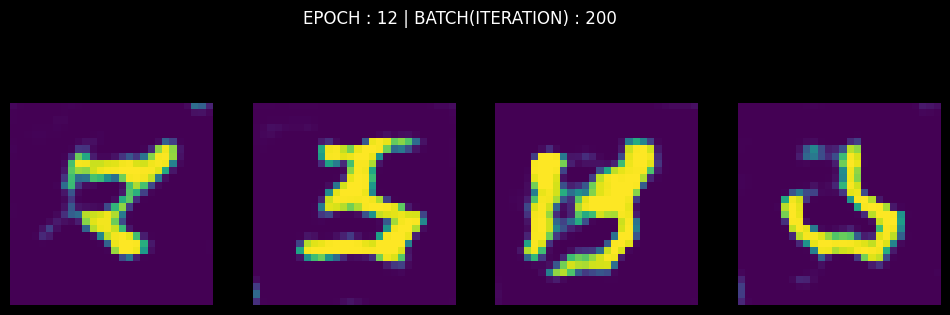

[Epoch: 12/50] [Batch: 235/235] [D loss: -0.002442] [G loss: -0.007150]


  0%|          | 0/235 [00:00<?, ?it/s]

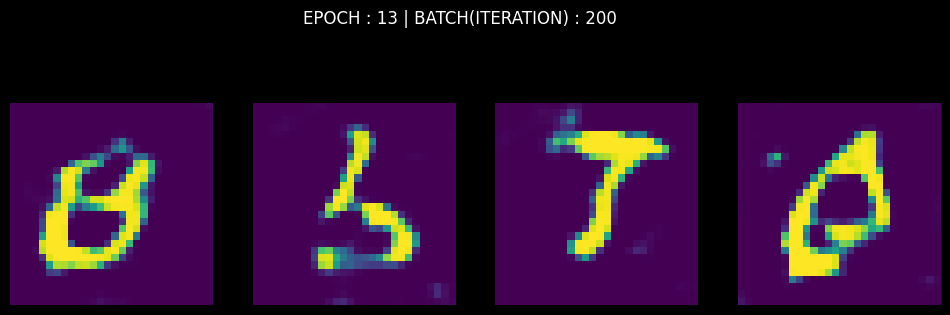

[Epoch: 13/50] [Batch: 235/235] [D loss: -0.003552] [G loss: -0.000803]


  0%|          | 0/235 [00:00<?, ?it/s]

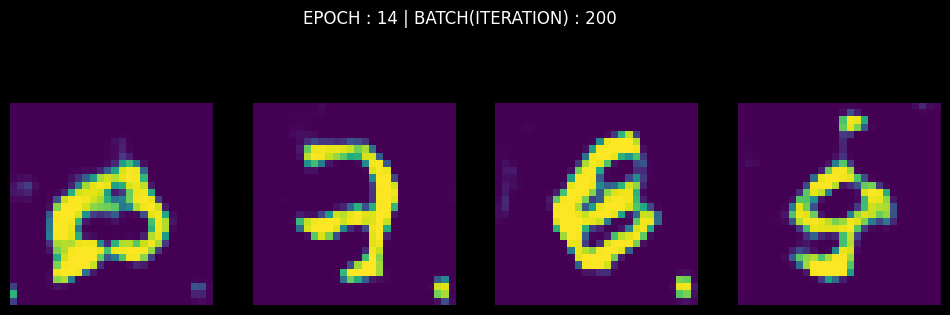

[Epoch: 14/50] [Batch: 235/235] [D loss: -0.003198] [G loss: -0.020479]


  0%|          | 0/235 [00:00<?, ?it/s]

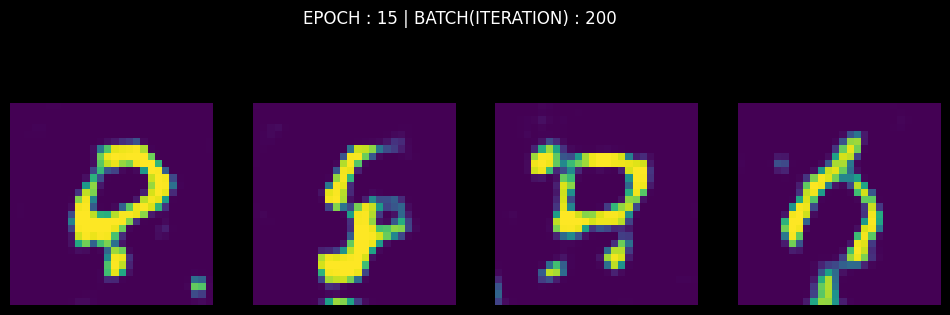

[Epoch: 15/50] [Batch: 235/235] [D loss: -0.002698] [G loss: -0.033396]


  0%|          | 0/235 [00:00<?, ?it/s]

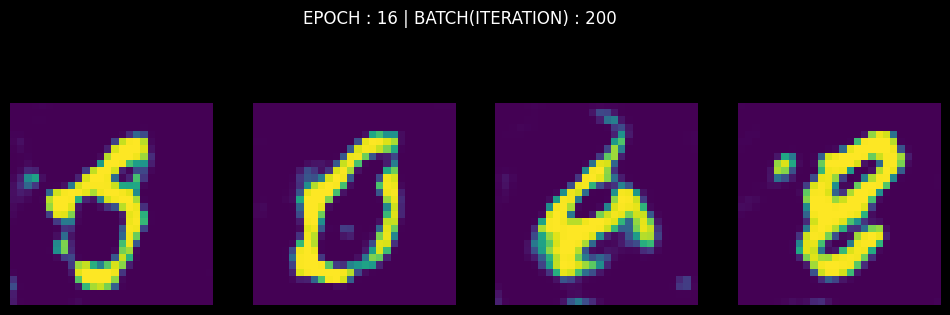

[Epoch: 16/50] [Batch: 235/235] [D loss: -0.003047] [G loss: 0.010341]


  0%|          | 0/235 [00:00<?, ?it/s]

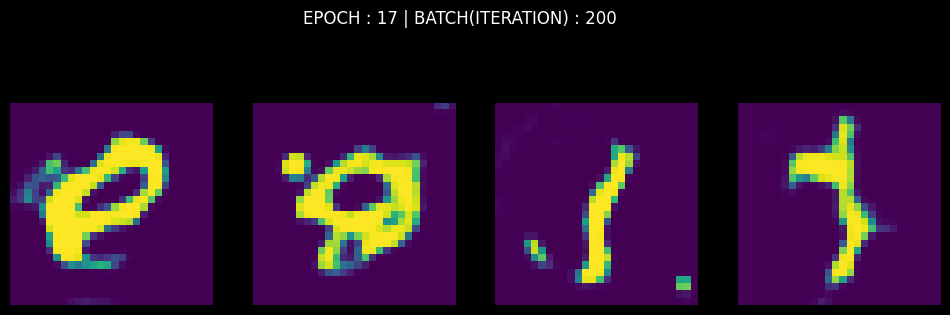

[Epoch: 17/50] [Batch: 235/235] [D loss: -0.002724] [G loss: -0.017381]


  0%|          | 0/235 [00:00<?, ?it/s]

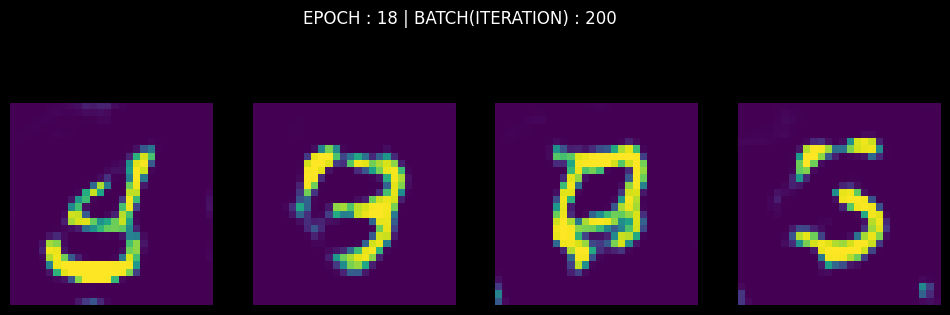

[Epoch: 18/50] [Batch: 235/235] [D loss: -0.002572] [G loss: -0.036349]


  0%|          | 0/235 [00:00<?, ?it/s]

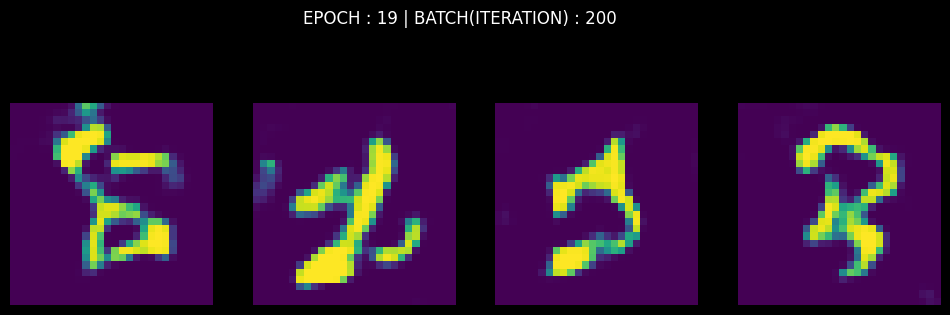

[Epoch: 19/50] [Batch: 235/235] [D loss: -0.003713] [G loss: -0.060239]


  0%|          | 0/235 [00:00<?, ?it/s]

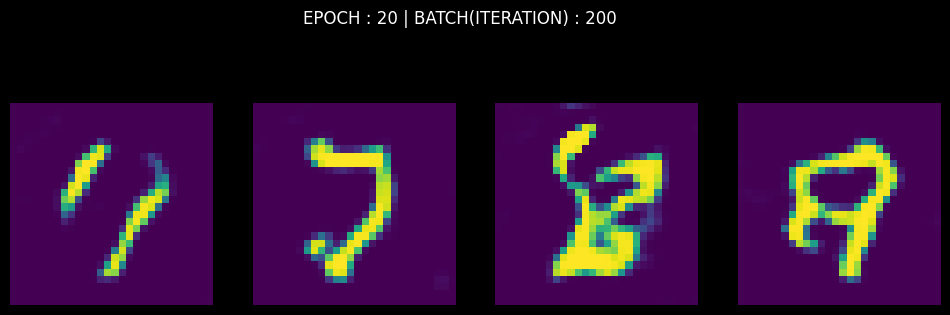

[Epoch: 20/50] [Batch: 235/235] [D loss: -0.002457] [G loss: 0.017420]


  0%|          | 0/235 [00:00<?, ?it/s]

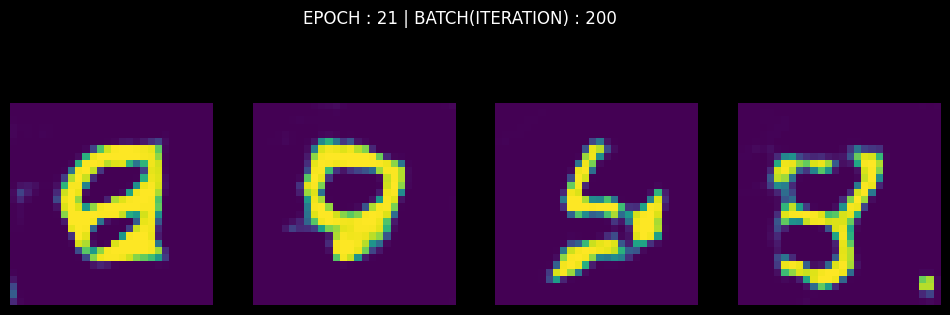

[Epoch: 21/50] [Batch: 235/235] [D loss: -0.002494] [G loss: -0.013398]


  0%|          | 0/235 [00:00<?, ?it/s]

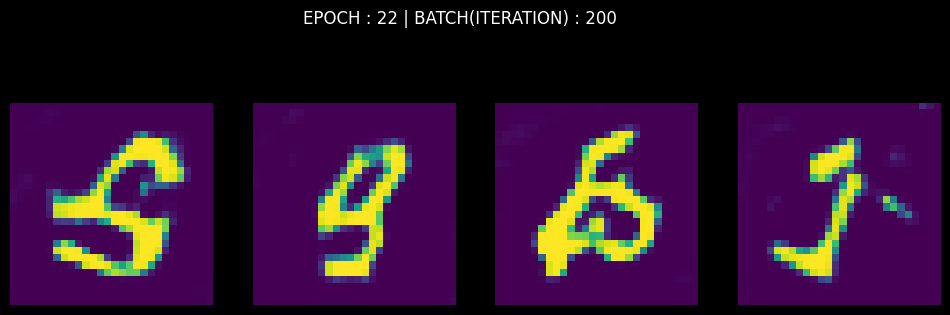

[Epoch: 22/50] [Batch: 235/235] [D loss: -0.001997] [G loss: 0.024880]


  0%|          | 0/235 [00:00<?, ?it/s]

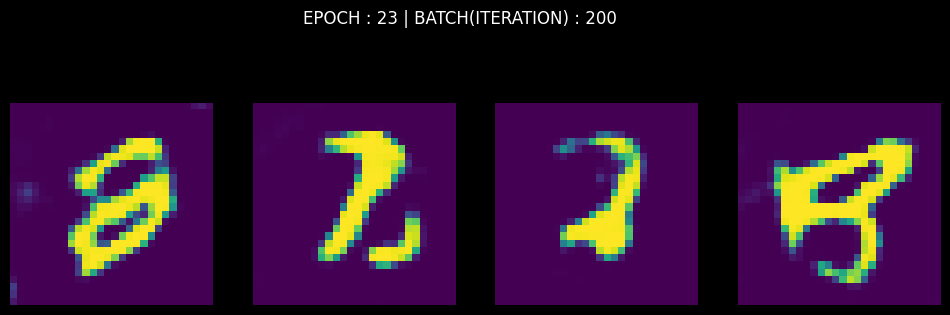

[Epoch: 23/50] [Batch: 235/235] [D loss: -0.002338] [G loss: 0.011907]


  0%|          | 0/235 [00:00<?, ?it/s]

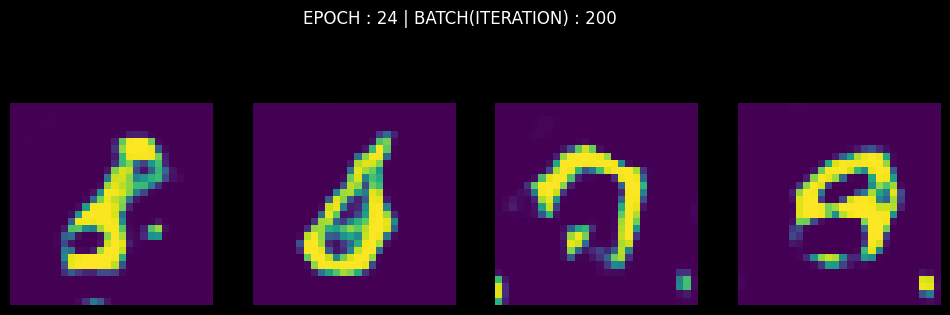

[Epoch: 24/50] [Batch: 235/235] [D loss: -0.002412] [G loss: 0.000072]


  0%|          | 0/235 [00:00<?, ?it/s]

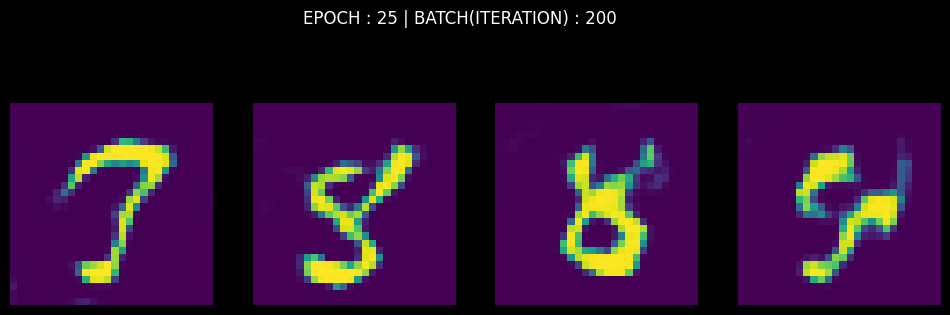

[Epoch: 25/50] [Batch: 235/235] [D loss: -0.002620] [G loss: -0.008977]


  0%|          | 0/235 [00:00<?, ?it/s]

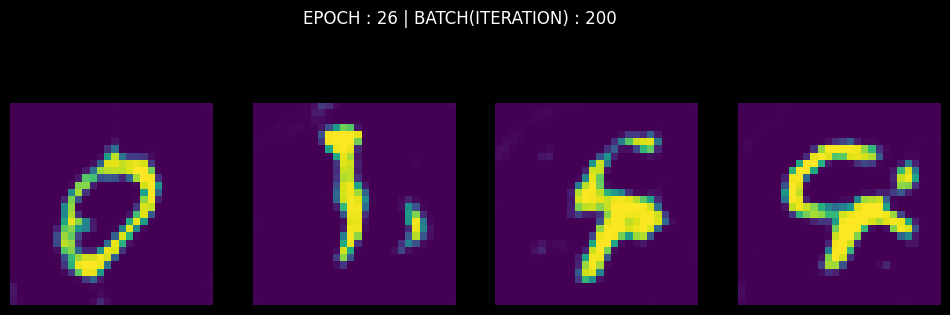

[Epoch: 26/50] [Batch: 235/235] [D loss: -0.002463] [G loss: -0.007899]


  0%|          | 0/235 [00:00<?, ?it/s]

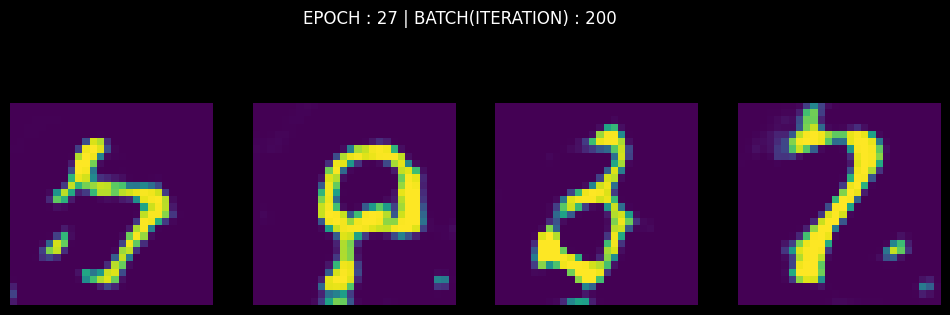

[Epoch: 27/50] [Batch: 235/235] [D loss: -0.002379] [G loss: -0.031632]


  0%|          | 0/235 [00:00<?, ?it/s]

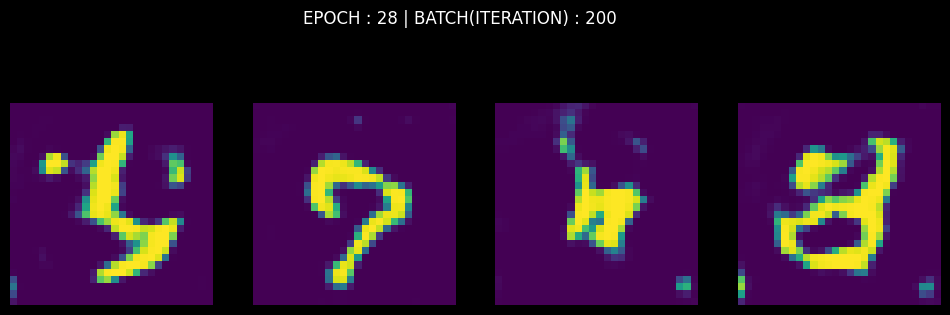

[Epoch: 28/50] [Batch: 235/235] [D loss: -0.002594] [G loss: -0.022601]


  0%|          | 0/235 [00:00<?, ?it/s]

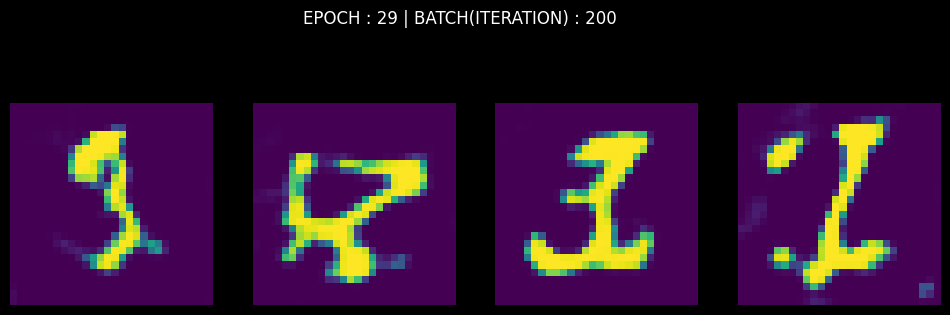

[Epoch: 29/50] [Batch: 235/235] [D loss: -0.002320] [G loss: 0.040792]


  0%|          | 0/235 [00:00<?, ?it/s]

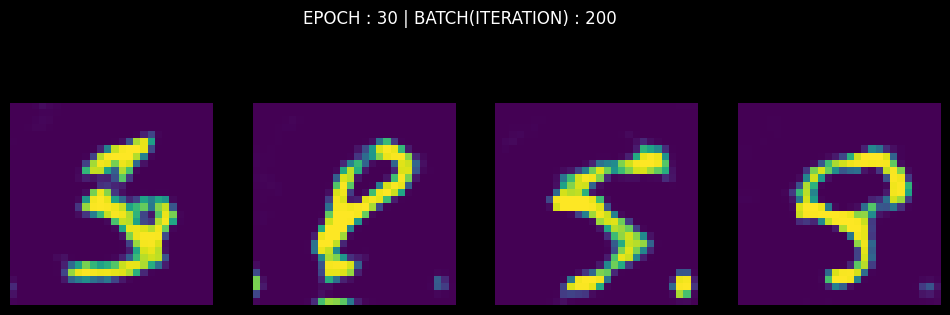

[Epoch: 30/50] [Batch: 235/235] [D loss: -0.003052] [G loss: 0.001571]


  0%|          | 0/235 [00:00<?, ?it/s]

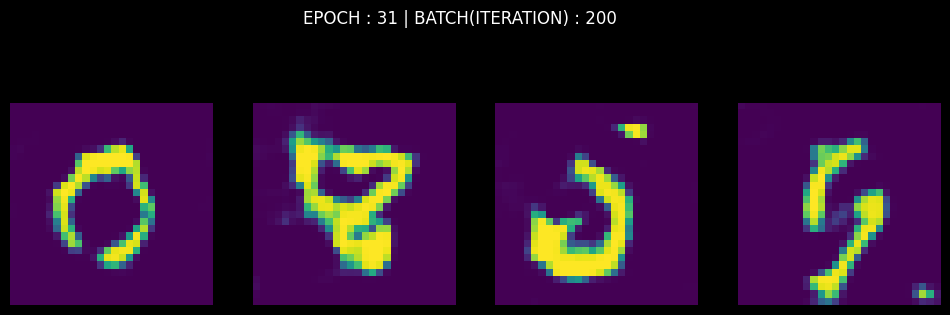

[Epoch: 31/50] [Batch: 235/235] [D loss: -0.001914] [G loss: 0.029070]


  0%|          | 0/235 [00:00<?, ?it/s]

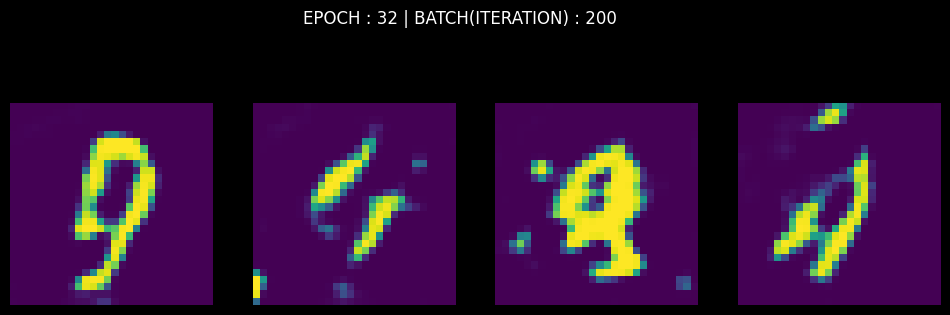

[Epoch: 32/50] [Batch: 235/235] [D loss: -0.003088] [G loss: 0.049845]


  0%|          | 0/235 [00:00<?, ?it/s]

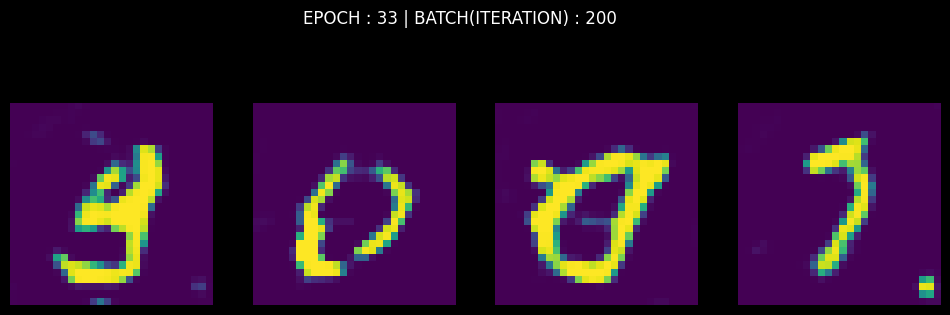

[Epoch: 33/50] [Batch: 235/235] [D loss: -0.002458] [G loss: -0.057551]


  0%|          | 0/235 [00:00<?, ?it/s]

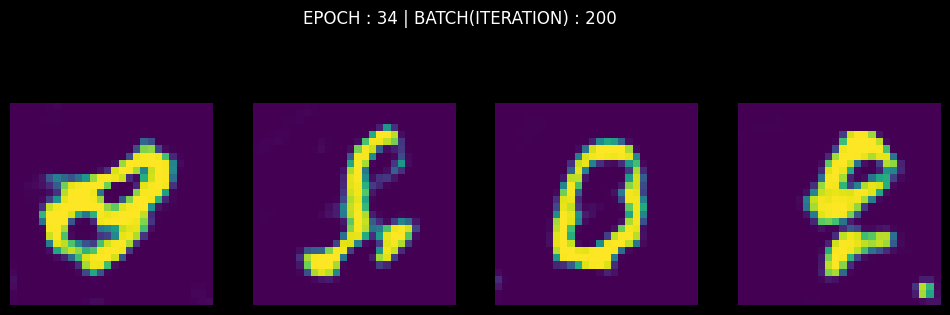

[Epoch: 34/50] [Batch: 235/235] [D loss: -0.002419] [G loss: 0.002375]


  0%|          | 0/235 [00:00<?, ?it/s]

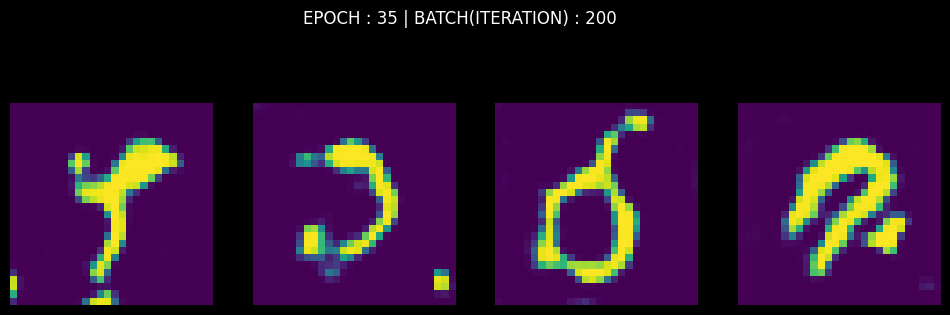

[Epoch: 35/50] [Batch: 235/235] [D loss: -0.002131] [G loss: 0.042634]


  0%|          | 0/235 [00:00<?, ?it/s]

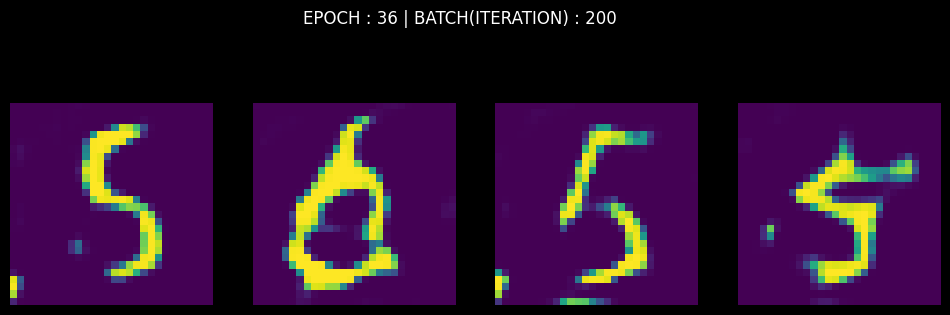

[Epoch: 36/50] [Batch: 235/235] [D loss: -0.001949] [G loss: -0.027378]


  0%|          | 0/235 [00:00<?, ?it/s]

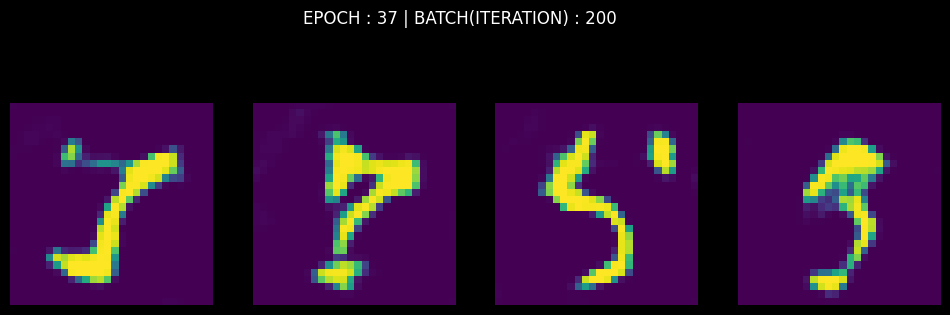

[Epoch: 37/50] [Batch: 235/235] [D loss: -0.002516] [G loss: -0.021098]


  0%|          | 0/235 [00:00<?, ?it/s]

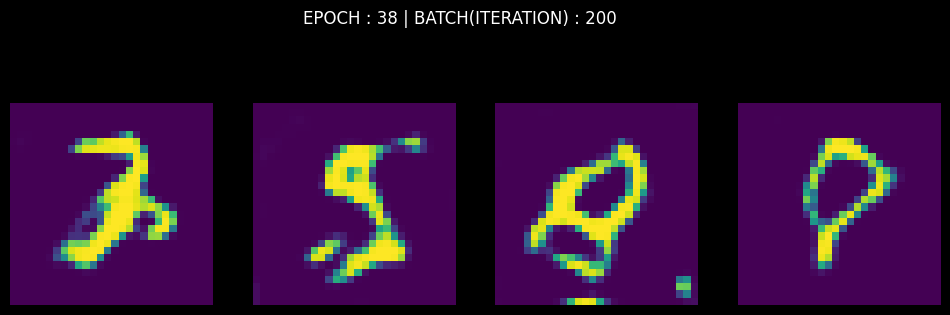

[Epoch: 38/50] [Batch: 235/235] [D loss: -0.002919] [G loss: 0.021325]


  0%|          | 0/235 [00:00<?, ?it/s]

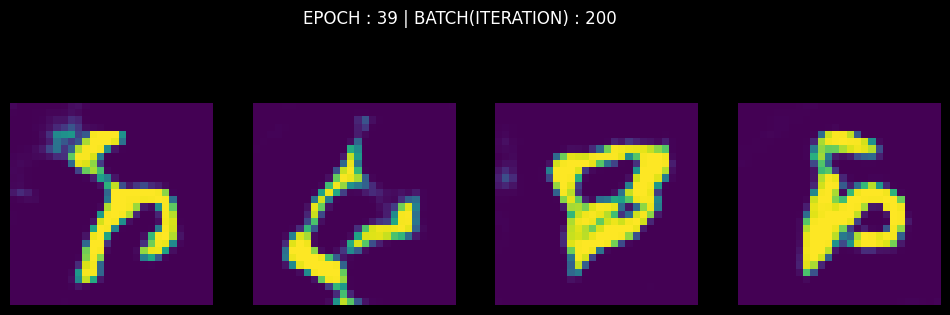

[Epoch: 39/50] [Batch: 235/235] [D loss: -0.002082] [G loss: 0.060293]


  0%|          | 0/235 [00:00<?, ?it/s]

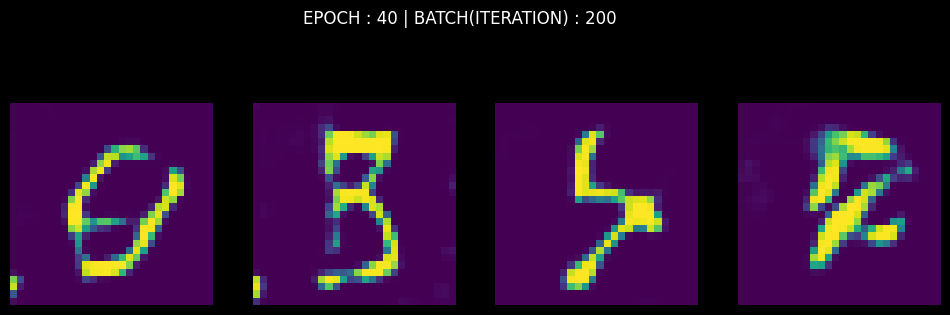

[Epoch: 40/50] [Batch: 235/235] [D loss: -0.002015] [G loss: -0.000716]


  0%|          | 0/235 [00:00<?, ?it/s]

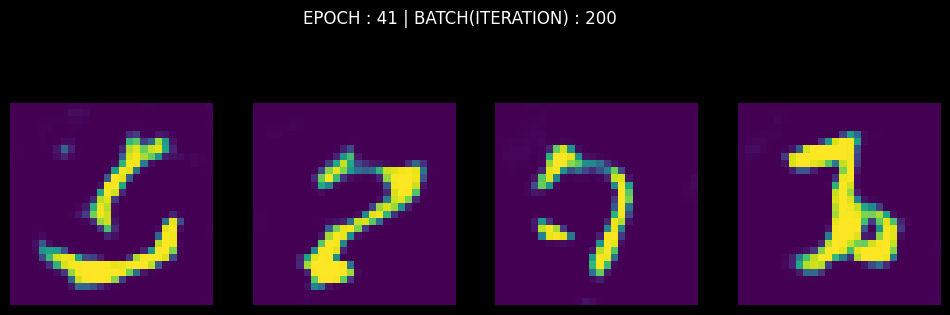

[Epoch: 41/50] [Batch: 235/235] [D loss: -0.001887] [G loss: 0.008261]


  0%|          | 0/235 [00:00<?, ?it/s]

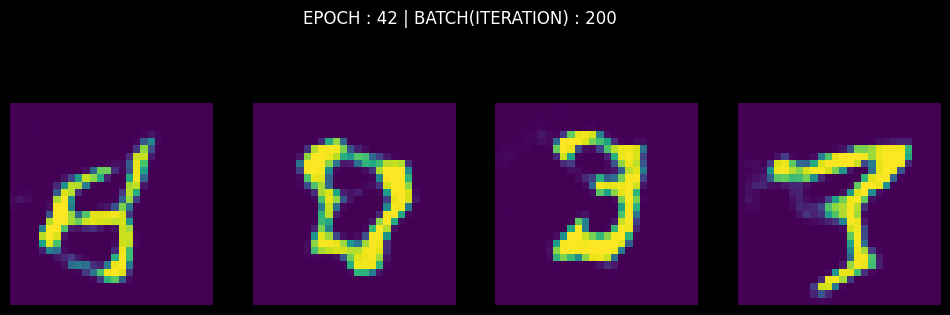

[Epoch: 42/50] [Batch: 235/235] [D loss: -0.001989] [G loss: -0.014424]


  0%|          | 0/235 [00:00<?, ?it/s]

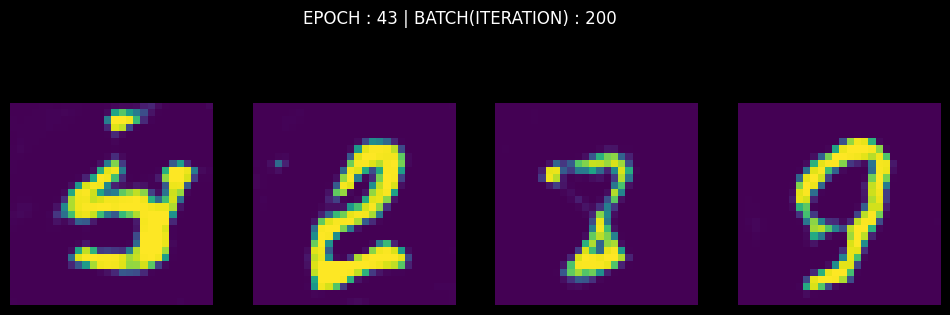

[Epoch: 43/50] [Batch: 235/235] [D loss: -0.003484] [G loss: 0.017193]


  0%|          | 0/235 [00:00<?, ?it/s]

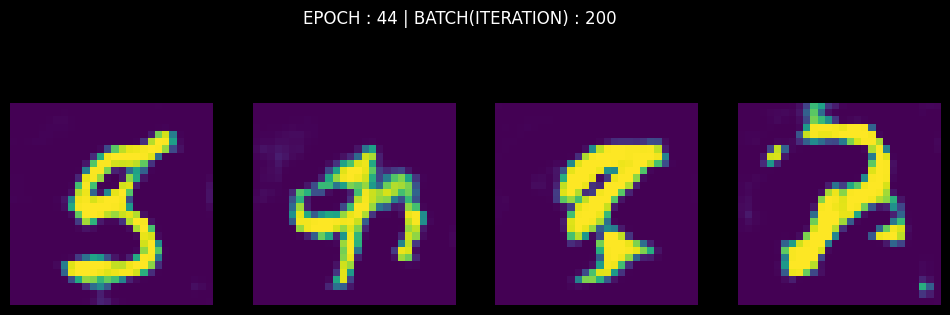

[Epoch: 44/50] [Batch: 235/235] [D loss: -0.001680] [G loss: -0.042907]


  0%|          | 0/235 [00:00<?, ?it/s]

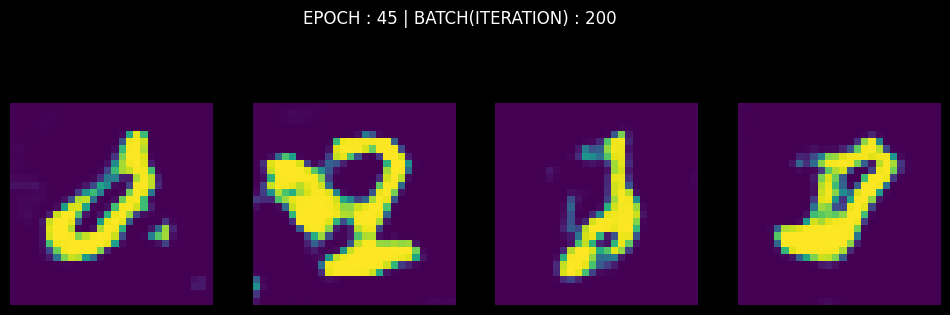

[Epoch: 45/50] [Batch: 235/235] [D loss: -0.001747] [G loss: -0.002291]


  0%|          | 0/235 [00:00<?, ?it/s]

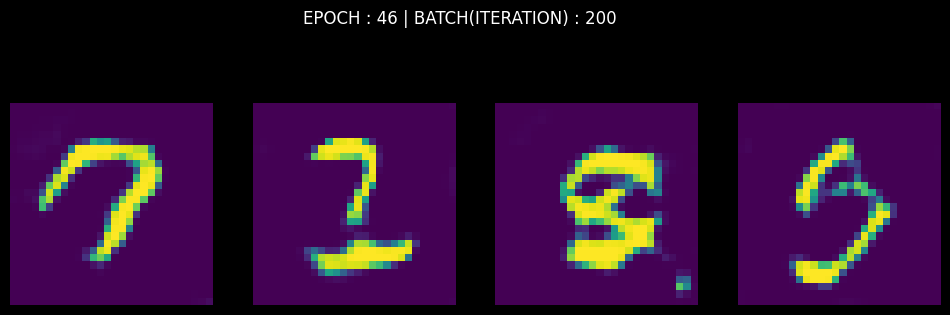

[Epoch: 46/50] [Batch: 235/235] [D loss: -0.001853] [G loss: 0.012301]


  0%|          | 0/235 [00:00<?, ?it/s]

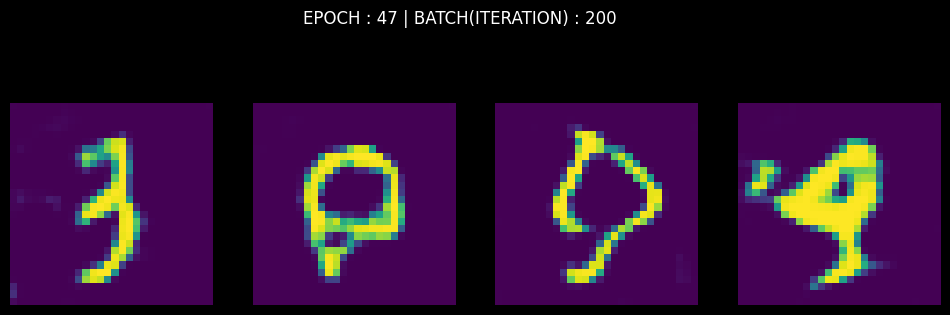

[Epoch: 47/50] [Batch: 235/235] [D loss: -0.001400] [G loss: 0.045645]


  0%|          | 0/235 [00:00<?, ?it/s]

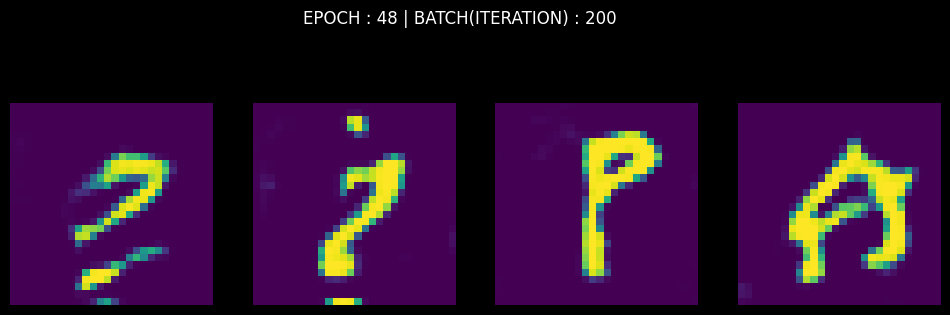

[Epoch: 48/50] [Batch: 235/235] [D loss: -0.002922] [G loss: 0.015541]


  0%|          | 0/235 [00:00<?, ?it/s]

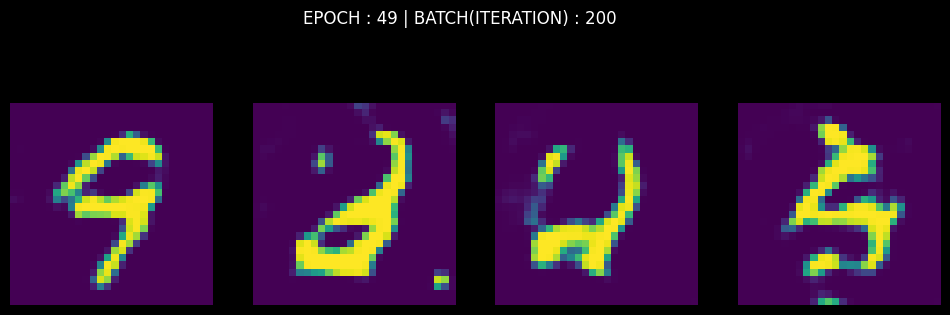

[Epoch: 49/50] [Batch: 235/235] [D loss: -0.002831] [G loss: 0.014851]


  0%|          | 0/235 [00:00<?, ?it/s]

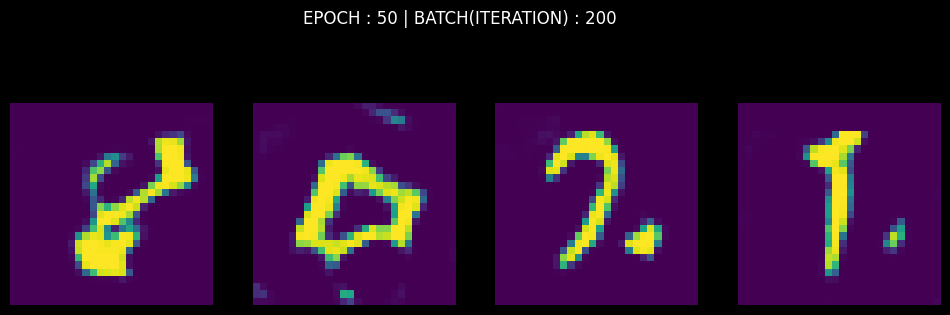

[Epoch: 50/50] [Batch: 235/235] [D loss: -0.002004] [G loss: 0.038865]


In [ ]:
losses_D_epoch = []
losses_G_epoch = []
for epoch in range(n_epochs):
    for i, (imgs, _) in enumerate(tqdm(dataloader)): # This code(enumerate) is dealt with once more in the *TEST_CODE below.
                                                     # Used 'tqdm' for showing progress
        losses_D = []
        losses_G = []

        real_imgs = Variable(imgs.type(Tensor))
        # Train Critic: max E[critic(real)] - E[critic(fake)]
        for _ in range(n_critic):
            z = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))
            fake_imgs = generator(z).detach()
            optimizer_D.zero_grad()
            loss_D = -torch.mean(discriminator(real_imgs).reshape(-1)) + torch.mean(discriminator(fake_imgs).reshape(-1))
            loss_D /= n_critic
            losses_D.append(loss_D.item())
            loss_D.backward(retain_graph=True)

            optimizer_D.step()
        for p in discriminator.parameters():
            p.data.clamp_(-clip_value, clip_value)


        optimizer_G.zero_grad()
        gen_imgs = generator(z)
        loss_G = -torch.mean(discriminator(gen_imgs).reshape(-1))
        losses_G.append(loss_G.item())
        loss_G.backward()
        optimizer_G.step()

        if ((i + 1) % sample_interval) == 0:  # show while batch - 200/657, 400/657, 600/657
            sample_z_in_train = Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim)))
            # z.shape == torch.Size([64, 100])
            sample_gen_imgs_in_train = generator(sample_z_in_train).detach().cpu()
            # gen_imgs.shape == torch.Size([64, 1, 28, 28])
            display_images(None, sample_gen_imgs_in_train, epoch=epoch, iteration=i)
    print(
        "[Epoch: %d/%d] [Batch: %d/%d] [D loss: %f] [G loss: %f]"
        % (epoch+1, n_epochs, i+1, len(dataloader), np.array(losses_D).mean(), np.array(losses_G).mean())
    )


# WGAN c штрафом градиента

Проблема: Очень глубокий дискриминатор не работает даже при пакетной нормализации.

$\large  \underset{g}{min}\underset{c}{max} \mathbb E(c(x)) - \mathbb E(c(g(z))) + \lambda reg$


$\large  \underset{g}{min}\underset{c}{max} \mathbb E(c(x)) - \mathbb E(c(g(z))) + \mathbb E(||c((\hat{x})|_2-1)^2$ 

$\lambda reg$ - Попытка сделать критерий 1-L непрерывным, чтобы функция потерь была непрерывной и дифференцируемой

![inter](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/inter.jpg)

Вычисление градиентного штрафа можно разбить на две части: (get_gradient) вычислить градиент относительно изображений и (gradient_penalty) вычислить градиентный штраф с учетом заданного градиента.

Начать можно с получения градиента. Градиент вычисляется путем создания смешанного изображения. Для этого необходимо взвесить фальшивое и реальное изображения с помощью epsilon и затем сложить их вместе. Получив промежуточное изображение, можно получить вывод критика по этому изображению. Наконец, вычисляется градиент оценки критика на смешанных изображениях (выход) относительно пикселей смешанных изображений (вход). 

In [ ]:
def get_gradient(disc, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and fake samples
    epsilon = torch.rand(real_samples.size(0), 1, 1, 1, device=device, requires_grad=True)
    # Mix the images together
    mixed_images = real_samples * epsilon + fake_samples * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = disc(mixed_images)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        inputs=mixed_images,
        outputs=mixed_scores,
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient

Вторая функция, которую необходимо выполнить - это вычисление градиентного штрафа с учетом градиента. Сначала вычисляется величина градиента каждого изображения. Величина градиента также называется нормой. Затем штрафуем среднее квадратичное расстояние норм градиента от 1. Штраф градиент позволяет выполнить критерий 1-L непрерывности, чтобы функция потерь была непрерывной и дифференцируемой.

In [ ]:
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)

    # Penalize the mean squared distance of the gradient norms from 1
    penalty = torch.mean((gradient_norm-1)**2)
    return penalty

In [ ]:
generator = Generator()
discriminator = Discriminator()
lambda_gp = 10
if cuda:
    generator.cuda()
    discriminator.cuda()
    device = torch.device("cuda")

optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta_1, beta_2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta_1, beta_2))

Необходимо отметить несколько моментов.
1.   Даже на GPU **обучение будет проходить медленнее**, чем в предыдущих версиях GAN, поскольку градиентный штраф требует вычисления градиента градиента - это означает потенциально несколько минут на эпоху! Для достижения наилучших результатов проведите обучение как можно дольше на GPU.
2.   Одно из важных отличий от предыдущих версий заключается в том, что при каждом обновлении генератора критик будет **обновляться несколько раз**. Это позволяет предотвратить перегрузку генератора критиком. Иногда может наблюдаться обратная ситуация, когда генератор обновляется чаще, чем критик. Это зависит от архитектурных (например, глубина и ширина сети) и алгоритмических решений (например, какие потери вы используете).
3.   WGAN-GP не обязательно предназначен для повышения общей производительности GAN, он лишь **увеличивает устойчивость** и позволяет избежать **mode collapse**. В целом, WGAN сможет обучаться гораздо стабильнее, чем ванильный DCGAN из прошлого задания, хотя в целом будет работать немного медленнее. Кроме того, вы сможете обучать модель большее количество эпох.

  0%|          | 0/235 [00:00<?, ?it/s]

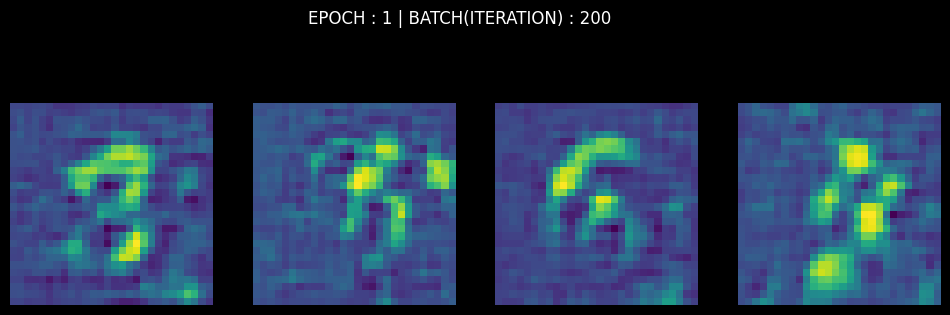

[Epoch: 1/50] [Batch: 235/235] [D loss: -38.377419] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

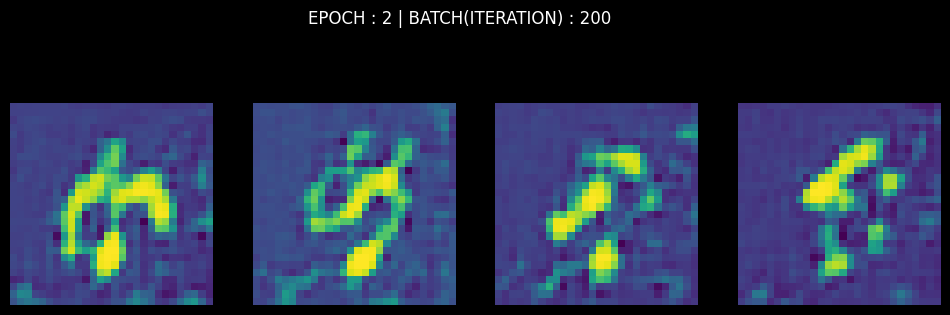

[Epoch: 2/50] [Batch: 235/235] [D loss: -50.260250] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

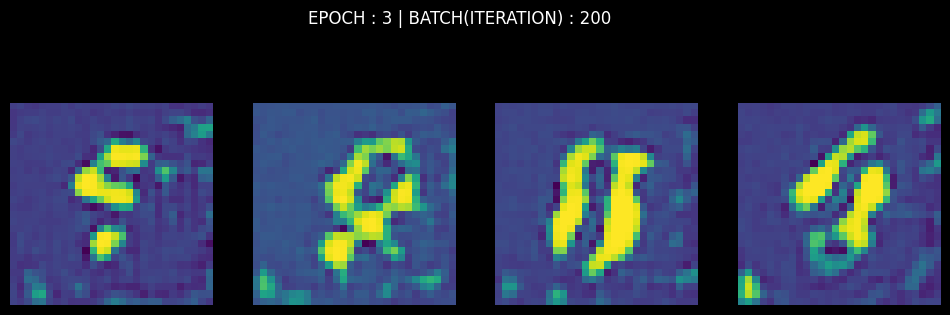

[Epoch: 3/50] [Batch: 235/235] [D loss: -58.978058] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

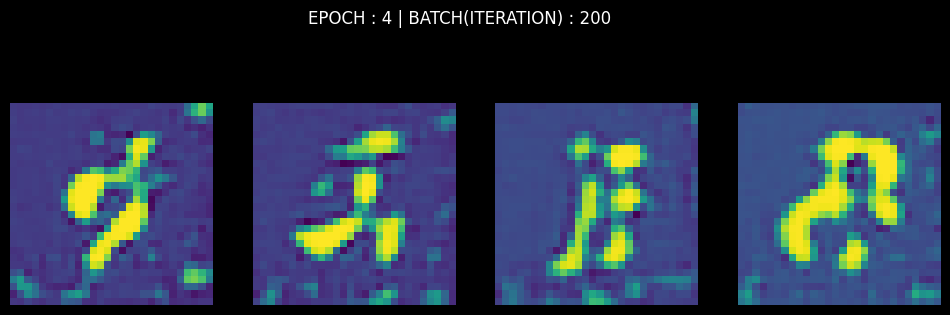

[Epoch: 4/50] [Batch: 235/235] [D loss: -67.190163] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

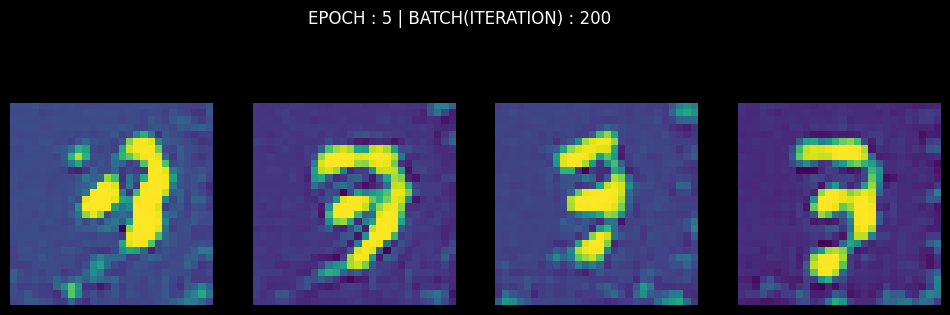

[Epoch: 5/50] [Batch: 235/235] [D loss: -73.733940] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

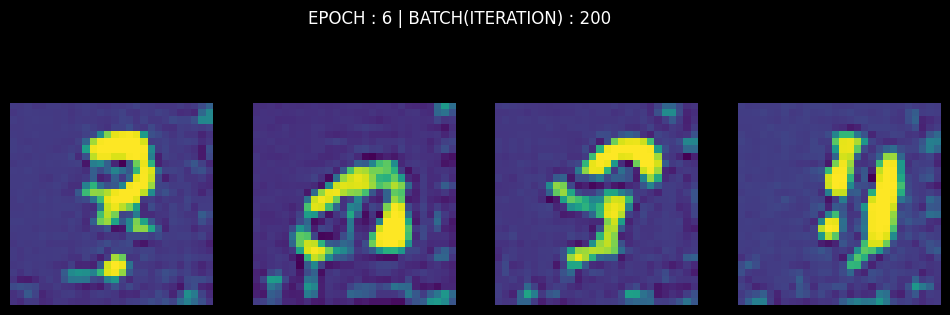

[Epoch: 6/50] [Batch: 235/235] [D loss: -71.591583] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

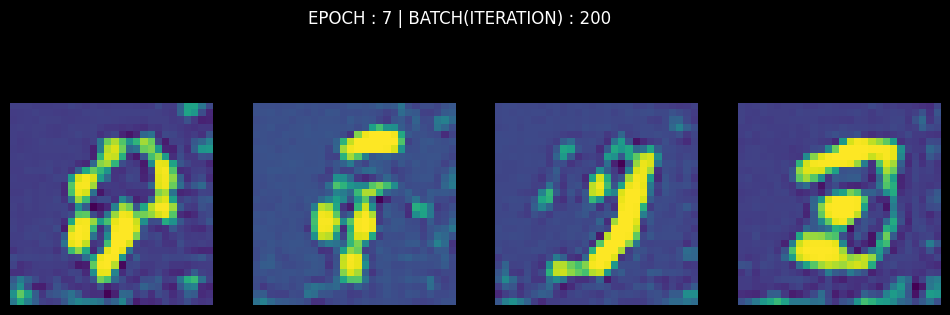

[Epoch: 7/50] [Batch: 235/235] [D loss: -109.346291] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

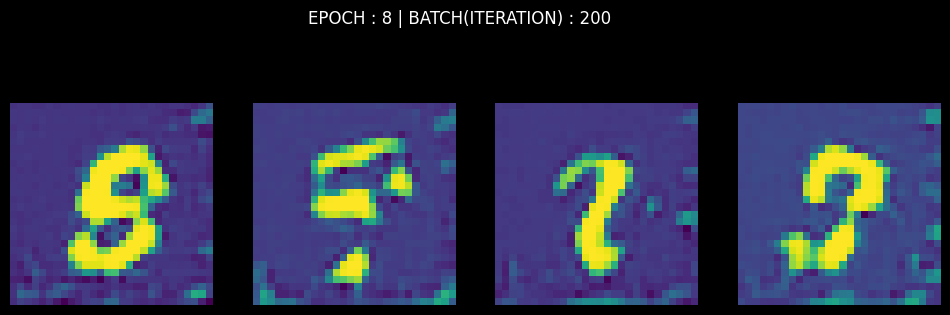

[Epoch: 8/50] [Batch: 235/235] [D loss: -129.303284] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

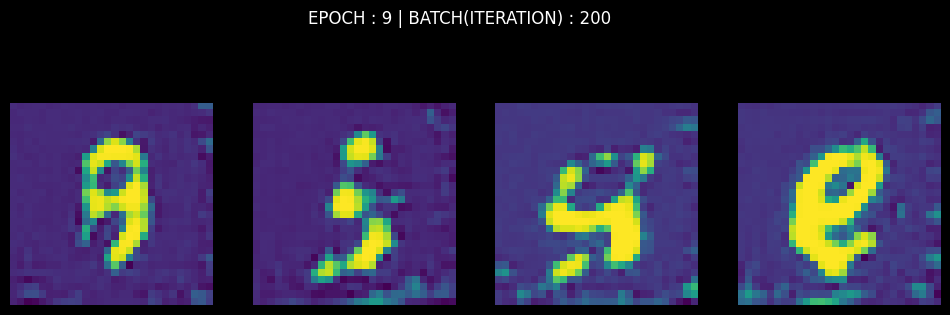

[Epoch: 9/50] [Batch: 235/235] [D loss: -126.133186] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

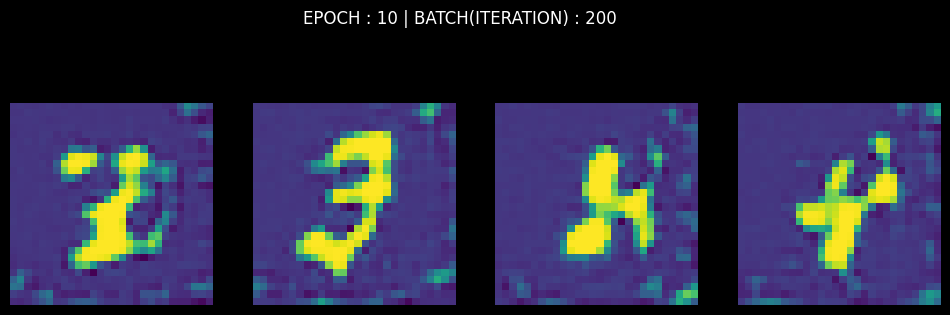

[Epoch: 10/50] [Batch: 235/235] [D loss: -176.286316] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

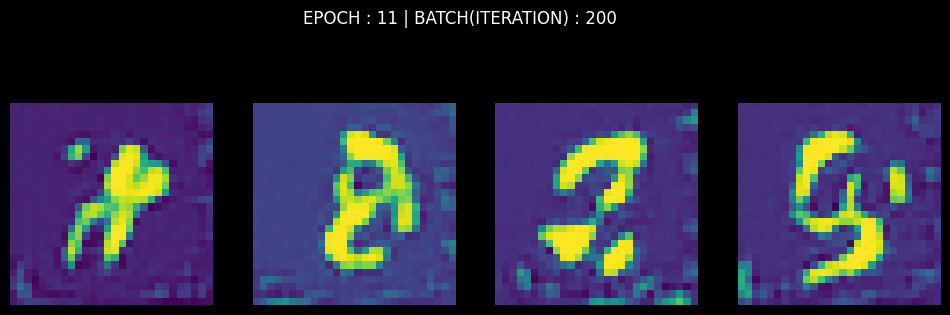

[Epoch: 11/50] [Batch: 235/235] [D loss: -142.291153] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

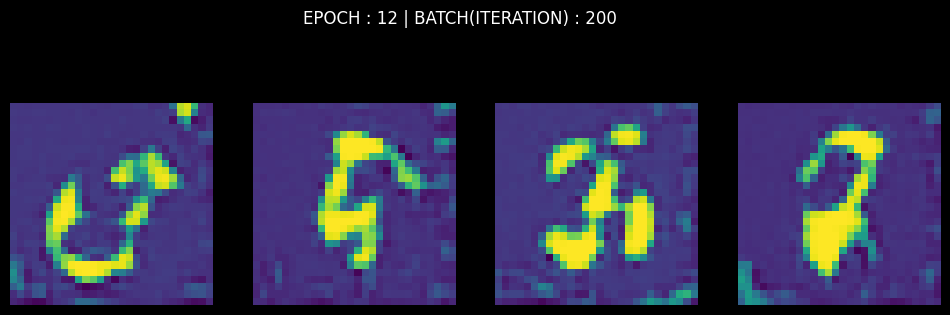

[Epoch: 12/50] [Batch: 235/235] [D loss: -153.593399] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

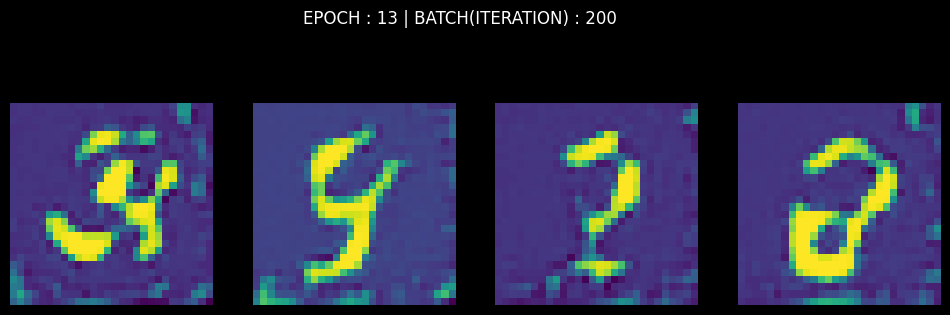

[Epoch: 13/50] [Batch: 235/235] [D loss: -163.948822] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

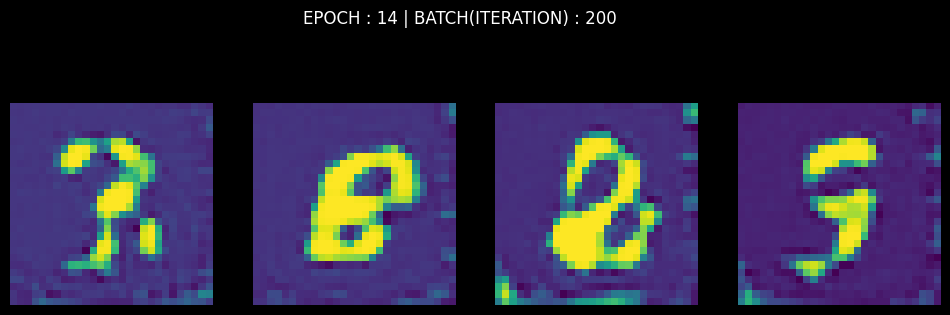

[Epoch: 14/50] [Batch: 235/235] [D loss: -146.008072] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

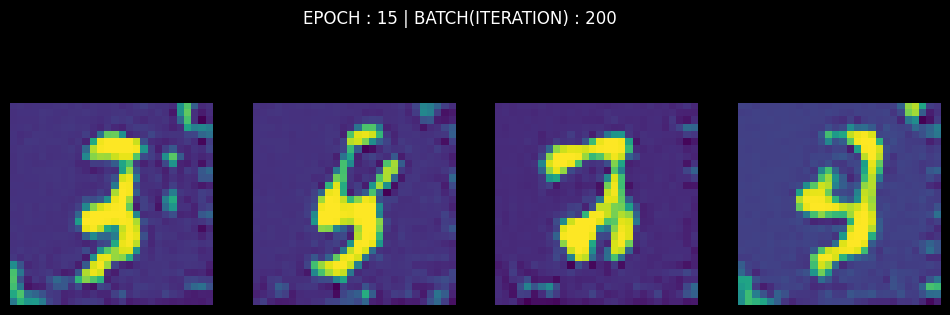

[Epoch: 15/50] [Batch: 235/235] [D loss: -161.172211] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

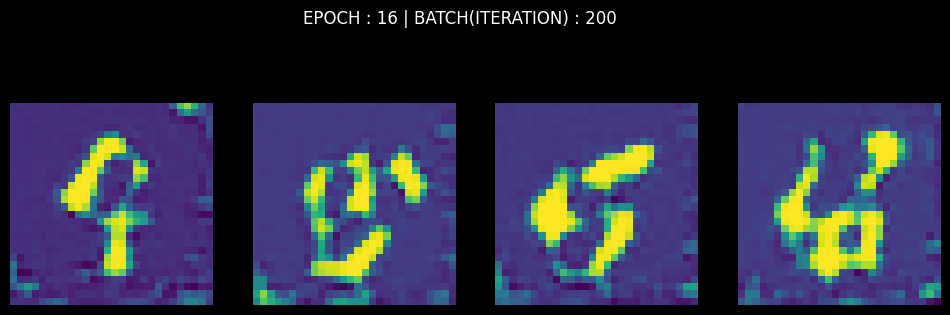

[Epoch: 16/50] [Batch: 235/235] [D loss: -149.466812] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

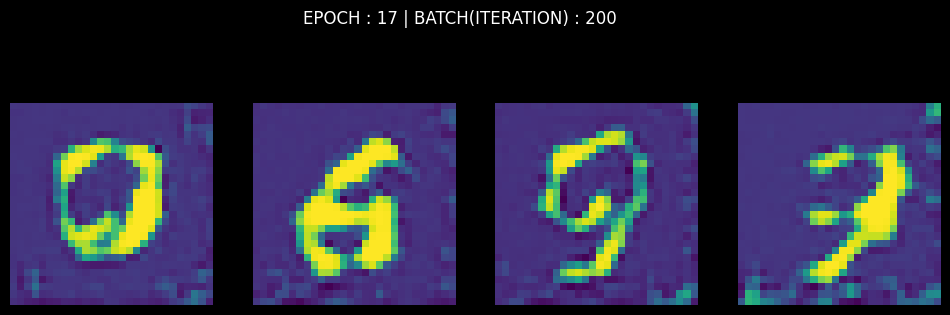

[Epoch: 17/50] [Batch: 235/235] [D loss: -93.043427] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

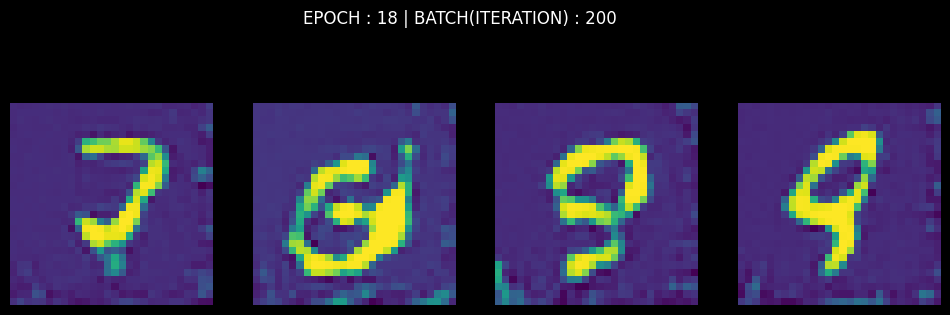

[Epoch: 18/50] [Batch: 235/235] [D loss: -185.490417] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

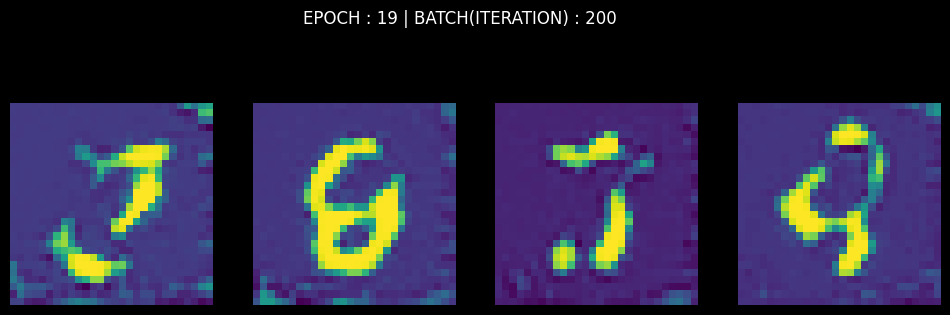

[Epoch: 19/50] [Batch: 235/235] [D loss: -167.557846] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

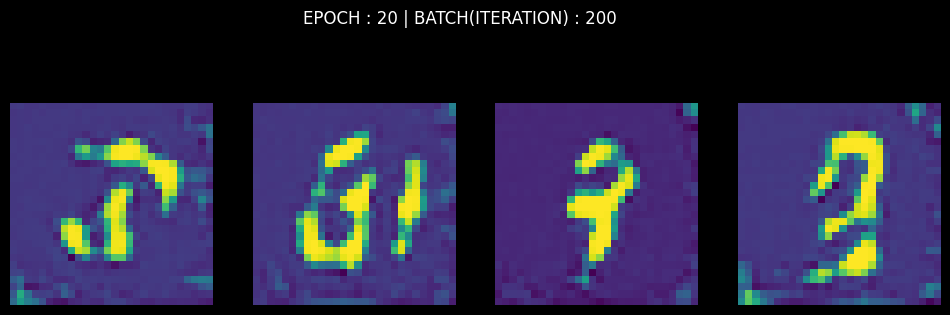

[Epoch: 20/50] [Batch: 235/235] [D loss: -165.355713] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

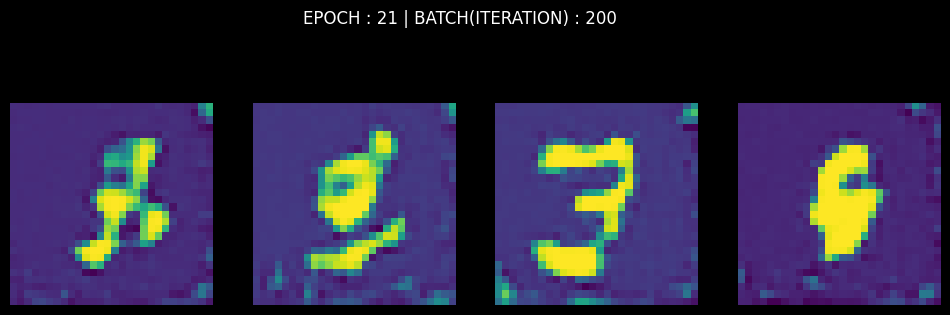

[Epoch: 21/50] [Batch: 235/235] [D loss: -209.252136] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

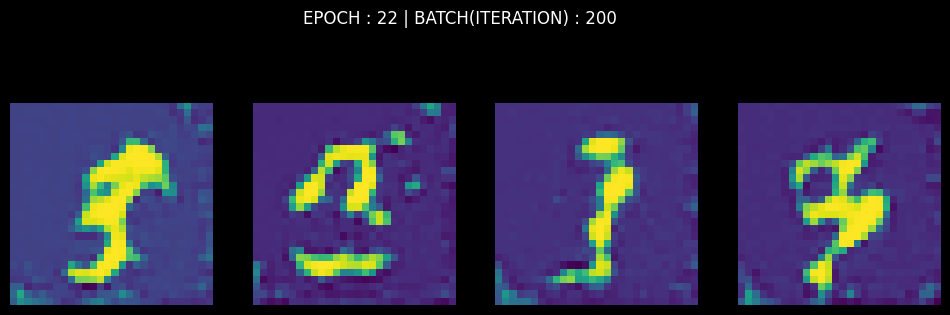

[Epoch: 22/50] [Batch: 235/235] [D loss: -203.607346] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

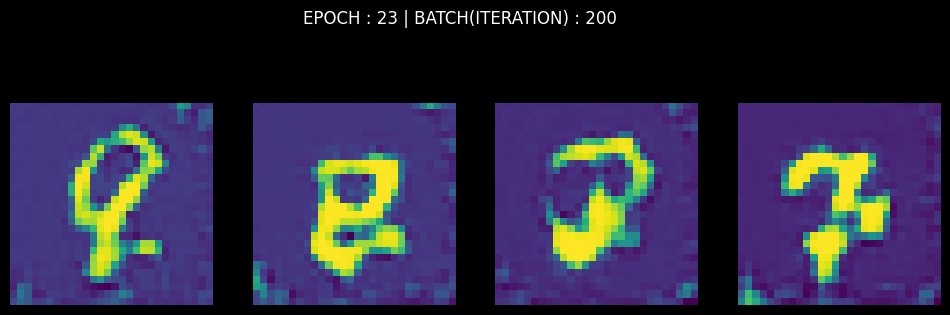

[Epoch: 23/50] [Batch: 235/235] [D loss: -244.716858] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

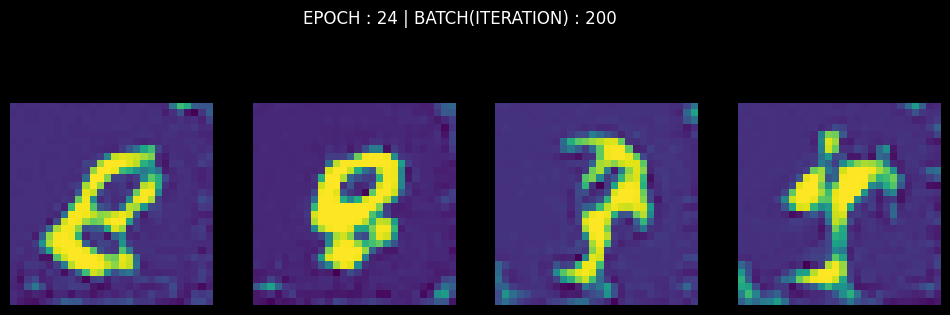

[Epoch: 24/50] [Batch: 235/235] [D loss: -193.622803] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

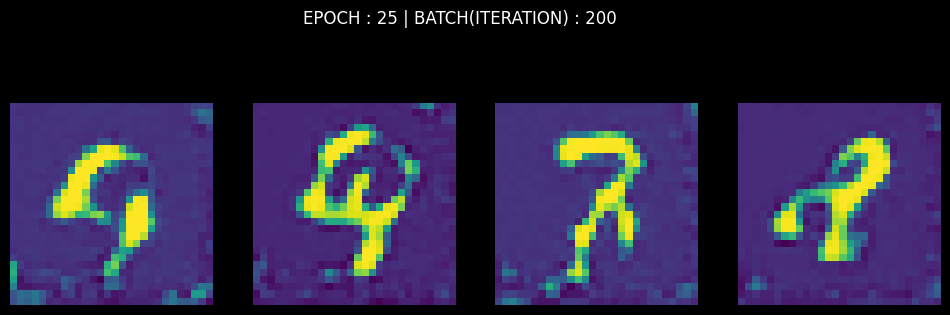

[Epoch: 25/50] [Batch: 235/235] [D loss: -257.992615] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

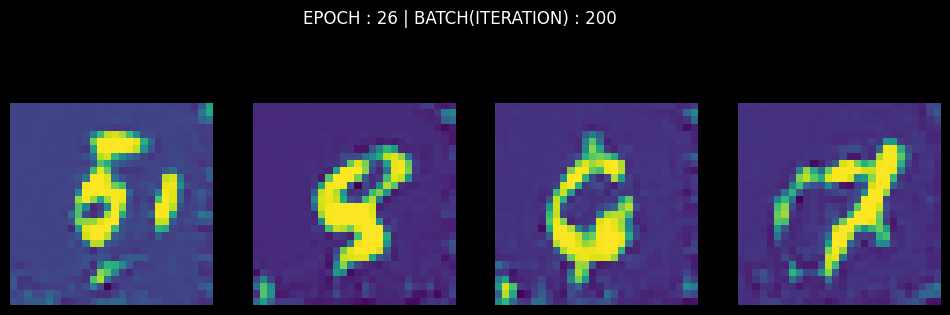

[Epoch: 26/50] [Batch: 235/235] [D loss: -177.533569] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

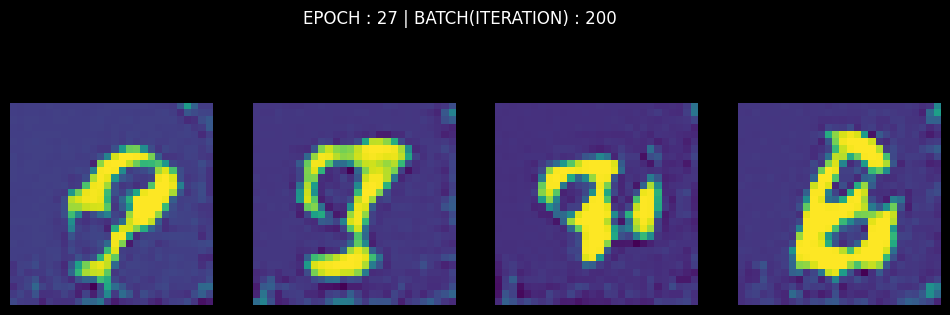

[Epoch: 27/50] [Batch: 235/235] [D loss: -217.309357] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

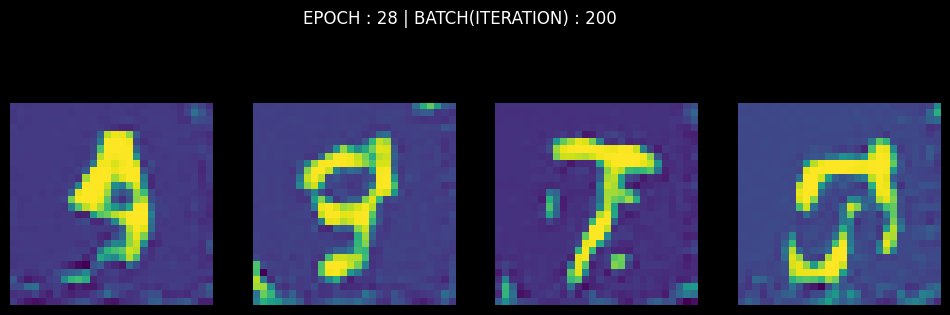

[Epoch: 28/50] [Batch: 235/235] [D loss: -235.314316] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

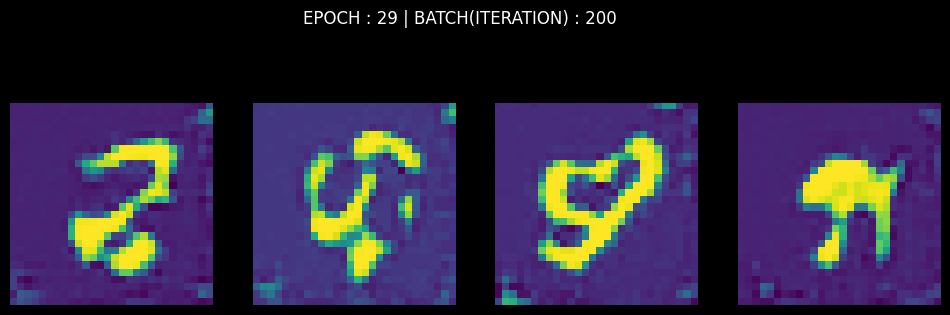

[Epoch: 29/50] [Batch: 235/235] [D loss: -209.916077] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

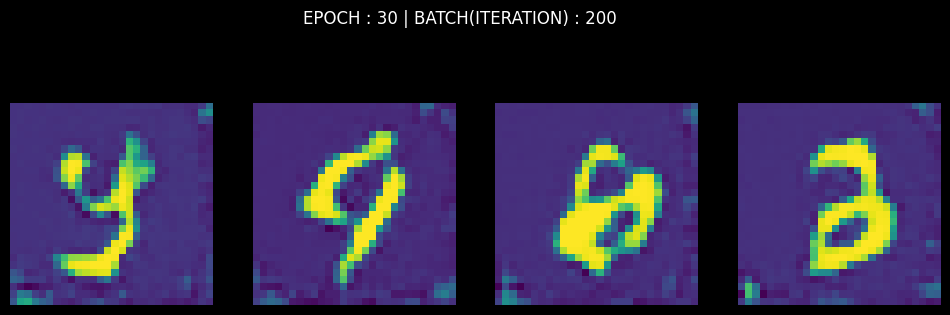

[Epoch: 30/50] [Batch: 235/235] [D loss: -206.988495] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

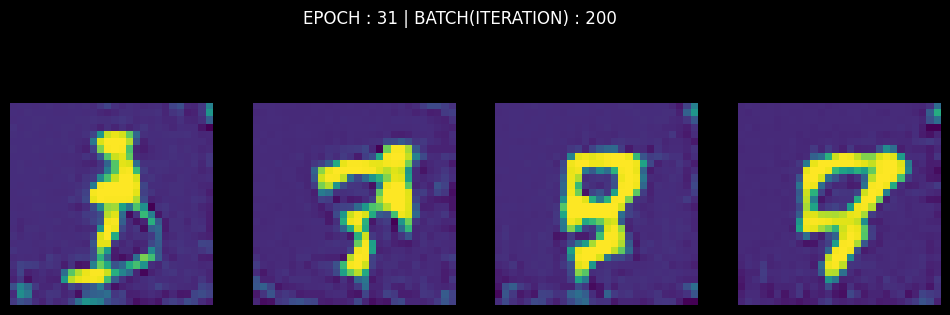

[Epoch: 31/50] [Batch: 235/235] [D loss: -281.170502] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

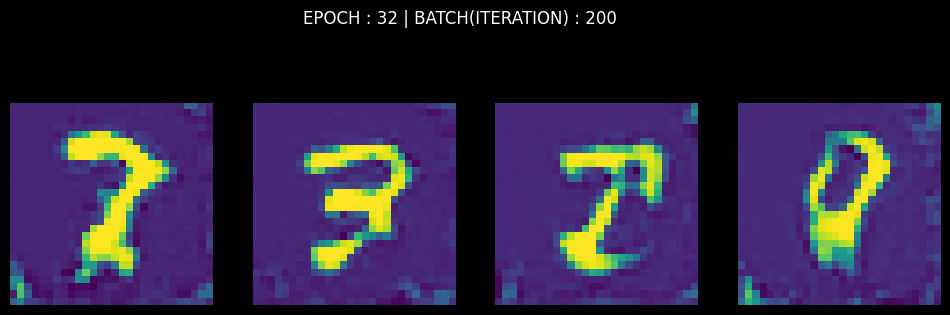

[Epoch: 32/50] [Batch: 235/235] [D loss: -199.242981] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

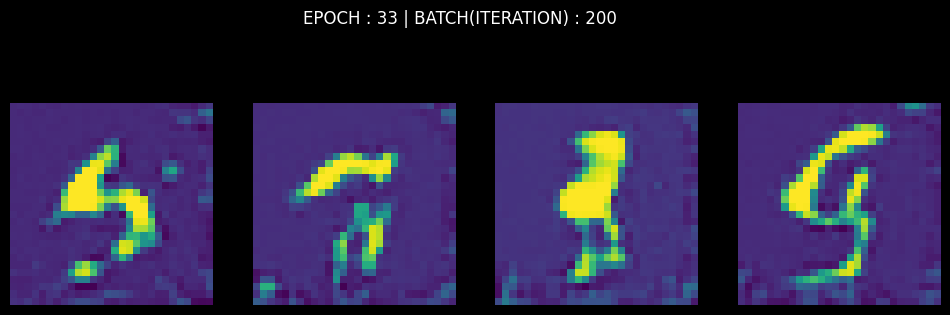

[Epoch: 33/50] [Batch: 235/235] [D loss: -258.319214] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

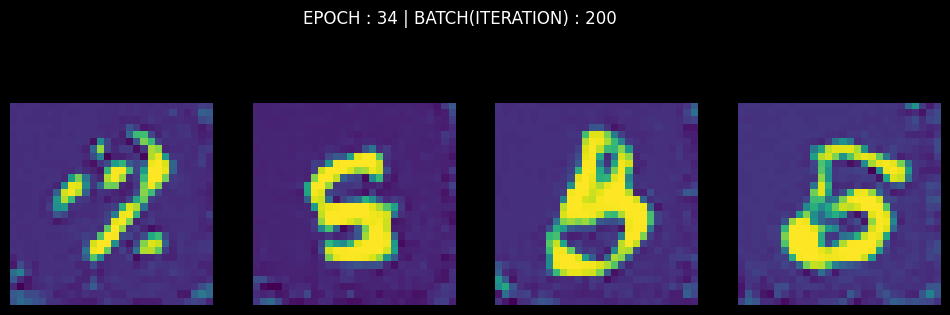

[Epoch: 34/50] [Batch: 235/235] [D loss: -214.578827] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

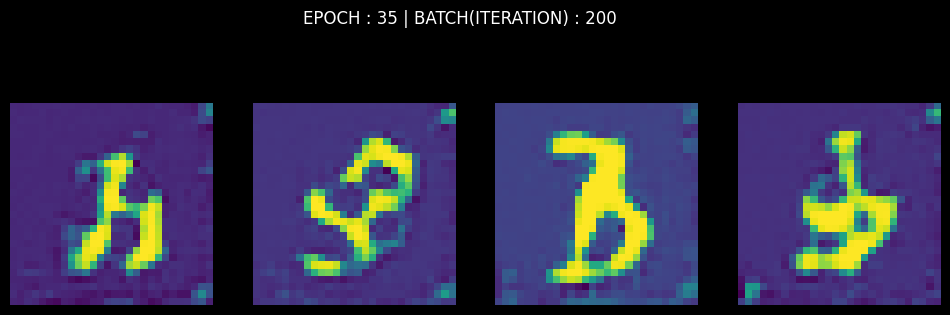

[Epoch: 35/50] [Batch: 235/235] [D loss: -433.641724] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

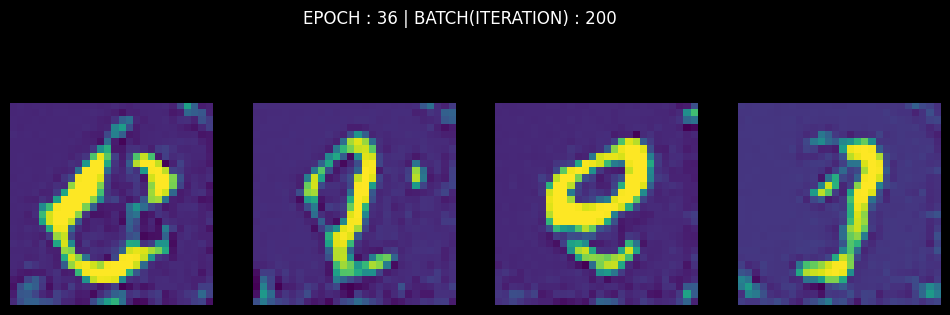

[Epoch: 36/50] [Batch: 235/235] [D loss: -268.401123] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

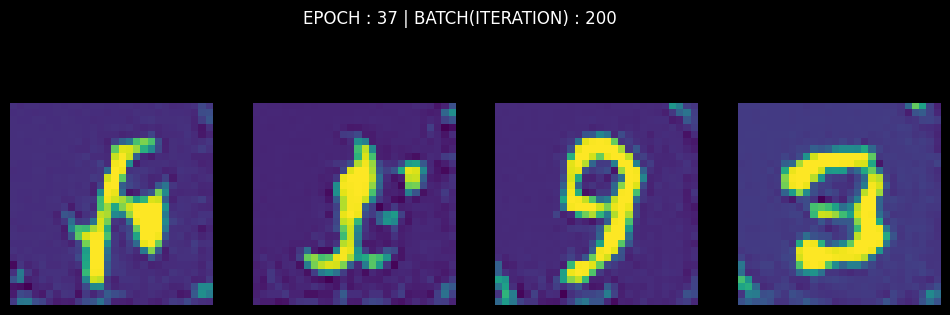

[Epoch: 37/50] [Batch: 235/235] [D loss: -231.851074] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

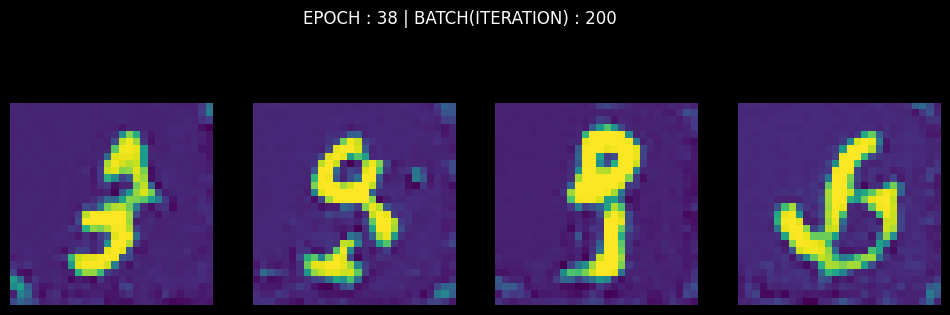

[Epoch: 38/50] [Batch: 235/235] [D loss: -273.588074] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

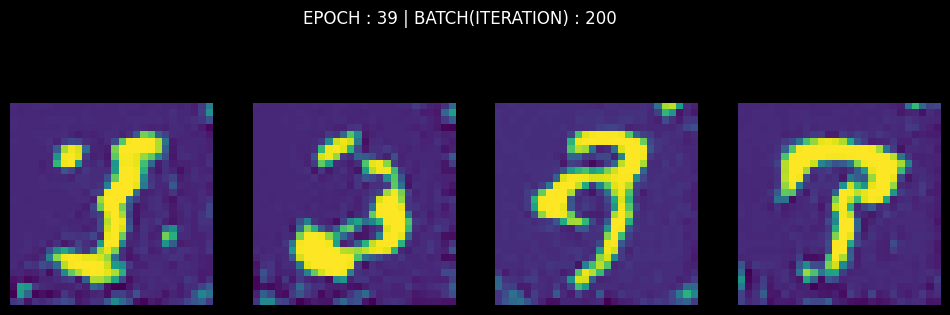

[Epoch: 39/50] [Batch: 235/235] [D loss: -243.623489] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

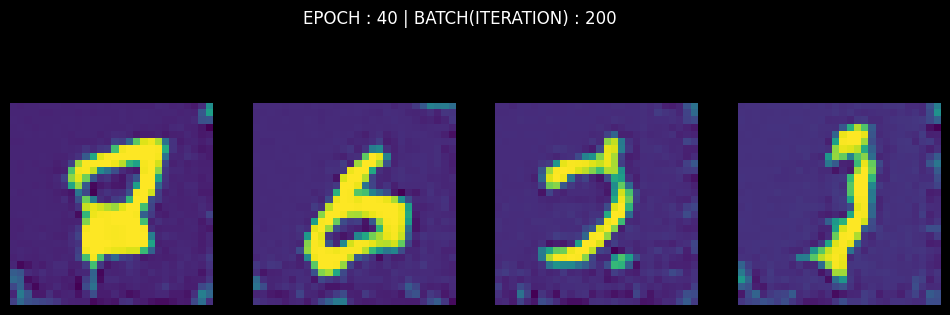

[Epoch: 40/50] [Batch: 235/235] [D loss: -356.569061] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

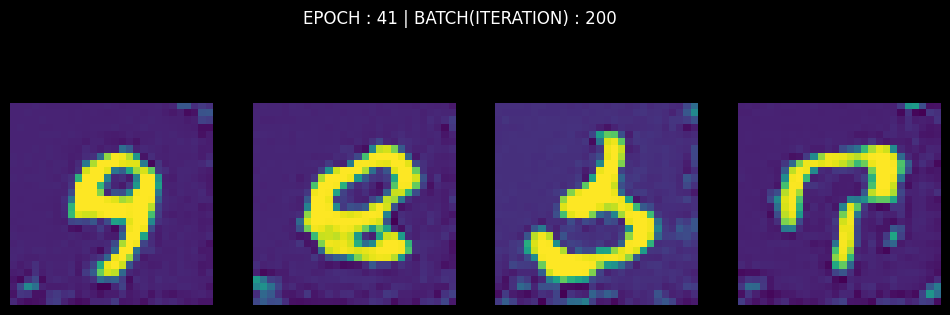

[Epoch: 41/50] [Batch: 235/235] [D loss: -278.126343] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

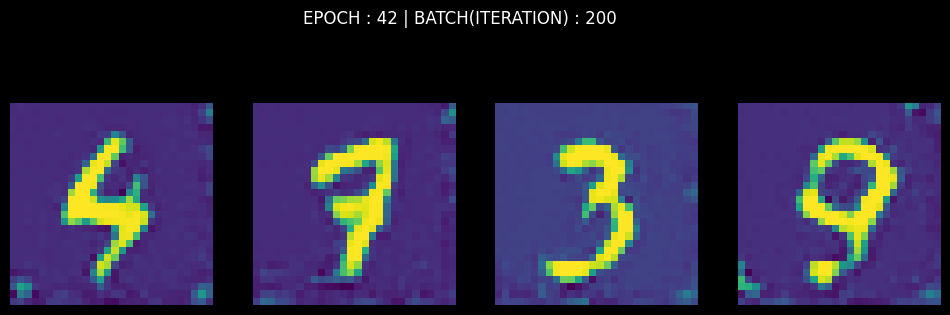

[Epoch: 42/50] [Batch: 235/235] [D loss: -330.717377] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

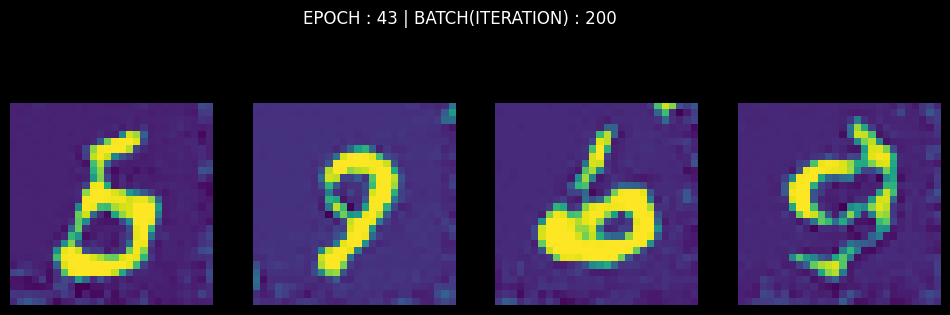

[Epoch: 43/50] [Batch: 235/235] [D loss: -433.892303] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

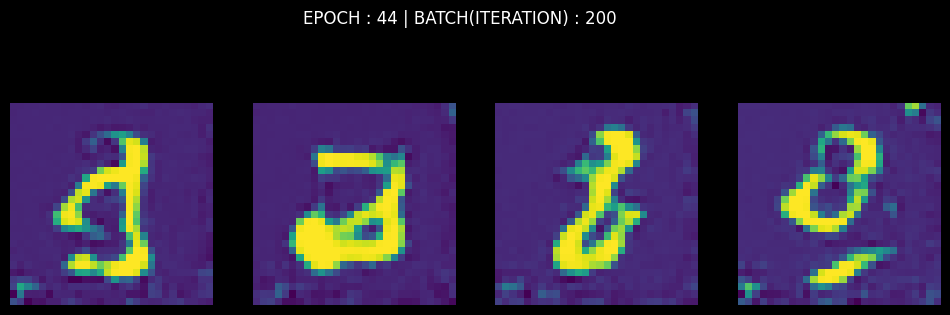

[Epoch: 44/50] [Batch: 235/235] [D loss: -273.059998] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

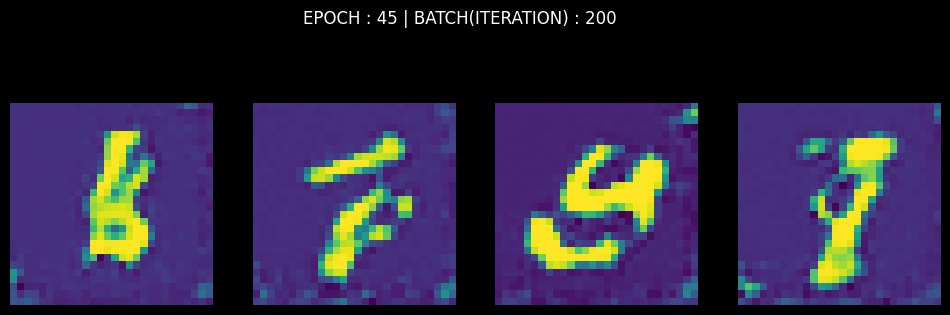

[Epoch: 45/50] [Batch: 235/235] [D loss: -295.829529] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

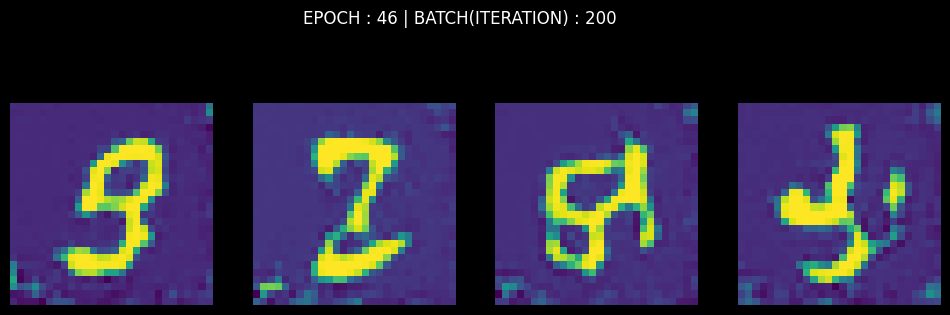

[Epoch: 46/50] [Batch: 235/235] [D loss: -187.368622] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

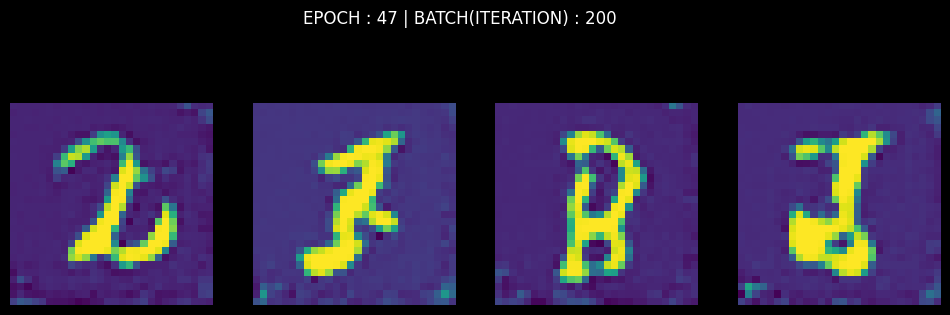

[Epoch: 47/50] [Batch: 235/235] [D loss: -146.062592] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

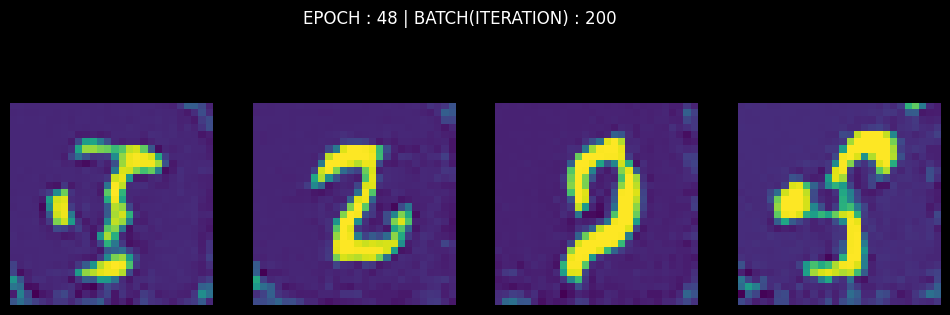

[Epoch: 48/50] [Batch: 235/235] [D loss: -520.324036] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

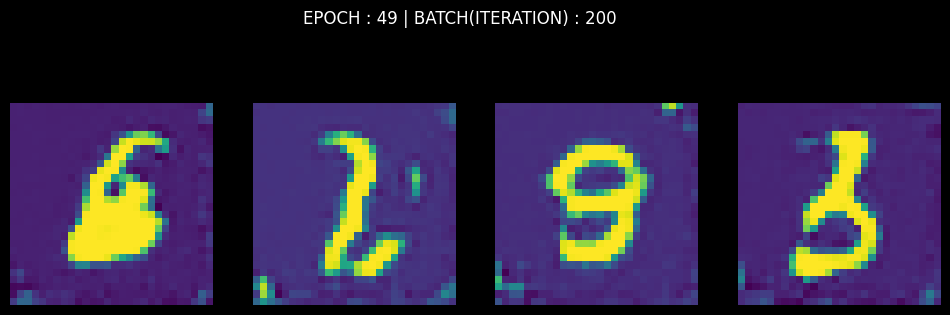

[Epoch: 49/50] [Batch: 235/235] [D loss: -290.326660] [G loss: 0.038865]


  0%|          | 0/235 [00:00<?, ?it/s]

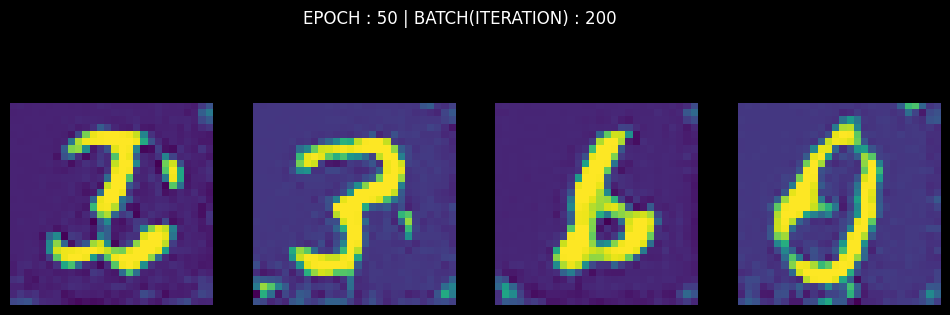

[Epoch: 50/50] [Batch: 235/235] [D loss: -601.724182] [G loss: 0.038865]


In [ ]:
for epoch in range(n_epochs):
    for i, (imgs, _) in enumerate(
            tqdm(dataloader)):  # This code(enumerate) is dealt with once more in the *TEST_CODE below.
        # Used 'tqdm' for showing progress

        real_imgs = Variable(imgs.type(Tensor))
        for _ in range(n_critic):
            z = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))
            fake_imgs = generator(z).detach()
            # Real images
            real_validity = discriminator(real_imgs).reshape(-1)
            # Fake images
            fake_validity = discriminator(fake_imgs).reshape(-1)
            gradient = get_gradient(discriminator, real_imgs, fake_imgs)
            gp = gradient_penalty(gradient)
            optimizer_D.zero_grad()
            loss_D = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gp
            loss_D.backward(retain_graph=True)
            optimizer_D.step()

        optimizer_G.zero_grad()
        fake_imgs = generator(z)
        # Loss measures generator's ability to fool the discriminator
        # Train on fake images
        fake_validity = discriminator(fake_imgs).reshape(-1)
        g_loss = -torch.mean(fake_validity)

        g_loss.backward()
        optimizer_G.step()



        if ((i + 1) % sample_interval) == 0:  # show while batch - 200/657, 400/657, 600/657
            sample_z_in_train = Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim)))
            # z.shape == torch.Size([64, 100])
            sample_gen_imgs_in_train = generator(sample_z_in_train).detach().cpu()
            # gen_imgs.shape == torch.Size([64, 1, 28, 28])
            display_images(None, sample_gen_imgs_in_train, epoch=epoch, iteration=i)
    print(
        "[Epoch: %d/%d] [Batch: %d/%d] [D loss: %f] [G loss: %f]"
        % (epoch + 1, n_epochs, i + 1, len(dataloader), loss_D.item(), loss_G.item())
    )


### Что  еще:
1. GP_V2. Дополнительный градиентный штраф
![v2](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/gp_v2.png)
2. Clip SVD (Video Gan)
3. [Спектральная нормализация](https://github.com/Kyrillos-Botros/Generative-Adversarial-Networks-GANs-Specialization-Coursera/blob/main/Course1-Build%20Basic%20Generative%20Adversarial%20Networks%20(GANs)/Week%203/Labs/SNGAN.ipynb) 
4. Ортогональная нормализация
5. Bidirectional Scaled Spectral Normalization (Зависит от инициализации Xavier or Kaiming)
6. 1-GP
7. zero-centered GP
8. 0-GP

In [ ]:
for epoch in range(n_epochs):
    for i, (imgs, _) in enumerate(
            tqdm(dataloader)):  # This code(enumerate) is dealt with once more in the *TEST_CODE below.
        # Used 'tqdm' for showing progress

        real_imgs = Variable(imgs.type(Tensor))
        for _ in range(n_critic):
            z = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))
            fake_imgs = generator(z).detach()
            # Real images
            real_validity = discriminator(real_imgs).reshape(-1)
            # Fake images
            fake_validity = discriminator(fake_imgs).reshape(-1)
            gradient = get_gradient(discriminator, real_imgs, fake_imgs)
            gp = gradient_penalty(gradient)
            optimizer_D.zero_grad()
            loss_D = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gp
            loss_D.backward(retain_graph=True)
            optimizer_D.step()

        optimizer_G.zero_grad()
        fake_imgs = generator(z)
        # Loss measures generator's ability to fool the discriminator
        # Train on fake images
        fake_validity = discriminator(fake_imgs).reshape(-1)
        g_loss = -torch.mean(fake_validity)

        g_loss.backward()
        optimizer_G.step()



        if ((i + 1) % sample_interval) == 0:  # show while batch - 200/657, 400/657, 600/657
            sample_z_in_train = Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim)))
            # z.shape == torch.Size([64, 100])
            sample_gen_imgs_in_train = generator(sample_z_in_train).detach().cpu()
            # gen_imgs.shape == torch.Size([64, 1, 28, 28])
            display_images(None, sample_gen_imgs_in_train, epoch=epoch, iteration=i)
    print(
        "[Epoch: %d/%d] [Batch: %d/%d] [D loss: %f] [G loss: %f]"
        % (epoch + 1, n_epochs, i + 1, len(dataloader), loss_D.item(), loss_G.item())
    )


## CycleGAN 

В этом ноутбуки мы напишем генеративную модель на основе статьи Unpaired Image-to-Image Translation using Cycle-Consistent Adversarial Networks, написанной Zhu et al. 2017 и обычно называемой CycleGAN.

Классический GAN состоят из двух нейронных сетей: генератора и дискриминатора. 
CycleGAN состоит из двух GAN, то есть из двух генераторов и двух дискриминаторов.

**Постановка задачи**: даны два набора различных изображений, например, картины Клода Моне, выполненные в технике масляной живописи  и реальные фотографии, то один генератор преобразует картины в фотографии, а другой - фотографии в картины. Мы будем обучать нашу модель конвертировать картины в фотографии и фотографии в картины. На этапе обучения дискриминаторы проверяют, являются ли изображения, вычисленные генераторами, настоящими или поддельными. В ходе этого процесса генераторы могут стать лучше благодаря обратной связи с соответствующими дискриминаторами. В случае CycleGAN генератор получает дополнительную обратную связь от другого генератора. Эта обратная связь гарантирует, что изображение, сгенерированное генератором, является циклически последовательным, т.е. последовательное применение обоих генераторов к изображению должно давать одинаковое изображение.

CycleGAN - первый алгоритм I2I, где не нужно размечать данные (данные непарные).

### Архитектура модели CycleGAN

На первый взгляд, архитектура CycleGAN кажется сложной.

Давайте вкратце рассмотрим все задействованные модели, их входы и выходы.

Рассмотрим задачу перевода изображений с летнего на зимнее и с зимнего на летнее.

У нас есть две коллекции фотографий, и они непарны, то есть представляют собой снимки разных мест в разное время; у нас нет абсолютно одинаковых сцен зимой и летом.

![cyclegan](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/CycleGanArchitecture.png)

В CycleGAN-подобных моделях для непарного перевода изображения в изображение используются две пары генераторов-дискриминаторов. Обозначим два домена изображений через A(**monet**) и B (**photo**). В модели типа CycleGAN для перевода изображений из $A$ в $B$ используется генератор $G_{A→B}$, а для перевода изображений из $B$ в $A$ - генератор $G_{B→A}$. Чтобы отличить изображений в A и переведенных из B (на рисунке обозначены как $A_f$) используется дискриминатор $D_A$, а для того чтобы определить реальное или сгенерированное изображение $B$ и $B_f$ - дискриминатор $D_B$.

Дискриминаторы обновляются путем обратного распространения потерь:

$L_{disc,A} = E_{x\sim B}ℓ_{GAN}(D_A(G_{B->A}(x)), 0) + E_{x\sim A}l_{GAN}(D_A(x),1)$

$L_{disc,B} = E_{x\sim A}ℓ_{GAN}(D_B(G_{A->B}(x)), 0) + E_{x\sim B}l_{GAN}(D_B(x),1)$

Здесь $ℓ_{GAN}$ может быть любой функцией потерь при классификации (L2, кросс-энтропия, Вассерштейна [5] и т.д.), а 0 и 1 - метки классов соответственно. метки классов для поддельных и реальных изображений соответственно. 

Генераторы обновляются путем обратного распространения потерь из трех источников: GAN-потери, потери от несоответствия циклов и потери от несоответствия идентичности.

На примере $G_{A→B}$:

$L_{GAN,A}=E_{x\sim A}ℓ_{GAN}(D_A(G_{A→B}(x)),1)$

$L_{cyc,A}=E_{x\sim A}ℓ_{reg}(G_{B→A}(G_{A→B}(x)),x)$

$L_{idt,A}=E_{x\sim A}ℓ_{reg}(G_{B→A}(x),x)$

И:

$L_{gen,A→B}=L_{GAN,A} + \lambda_{cyc} L_{cyc, A} + \lambda_{idt}L_{idt,A}$

$L_{gen,B→A}=L_{GAN,B} + \lambda_{cyc} L_{cyc, B} + \lambda_{idt}L_{idt,B}$

Здесь $ℓ_{reg}$ может быть любой функцией потерь при регрессии (L1 или L2, и т.д.), а $\lambda_{cyc}$ и $\lambda_{idt}$ - гиперпараметры.

In [24]:
import numpy as np

import torchvision.transforms as transforms
from torchvision.utils import make_grid

from torch.utils.data import DataLoader, Dataset
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch

from PIL import Image
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings

import os
import glob

In [3]:
from huggingface_hub import hf_hub_download

cycle_gan_data_path = hf_hub_download(repo_id="mteterin19/GAI", filename="cyclegan.tar.xz")

In [4]:
!tar -xf {cycle_gan_data_path}

In [5]:
dataset_name = 'cyclegan'
root = './'+dataset_name

In [26]:
# data (img)
img_height = 256
img_width = 256
channels = 3

# training
epoch = 0 # epoch to start training from
n_epochs = 5 # number of epochs of training
batch_size = 1 # size of the batches
lr = 0.0002 # adam : learning rate
b1 = 0.5 # adam : decay of first order momentum of gradient
b2 = 0.999 # adam : decay of first order momentum of gradient
decay_epoch = 3 # suggested default : 100 (suggested 'n_epochs' is 200)
                 # epoch from which to start lr decay

## Генератор
Предшественник Pix2Pix:
В Pix2Pix для генератора использовали архитектуру, основанную на "U-Net", а для дискриминатора - сверточный классификатор "PatchGAN", который наказывает структуру только в масштабе части изображения.


Код генератора CycleGAN во многом напоминает U-Net от Pix2Pix с добавлением ResidualBlock между кодирующим (сужающимся) и декодирующим (расширяющимся) блоками.

![Generator](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/CycleGAN_Generator.png)
*Диаграмма генератора CycleGAN: состоит из энкодера, остаточных блоков и декодера*

#### Остаточный блок
Изначально 
Пожалуй, наиболее заметным архитектурным отличием U-сети, использованной в Pix2Pix, от архитектуры, используемой в CycleGAN, являются остаточные блоки. В CycleGAN после расширяющих блоков идут конволюционные слои, где выходной сигнал в конечном итоге добавляется к исходному входному, чтобы сеть могла как можно меньше изменять изображение. Это преобразование можно рассматривать как своего рода пропуск соединения, когда вместо того, чтобы конкатенировать новые каналы перед сверткой, которая их объединяет, они добавляются непосредственно к выходу свертки. На приведенной ниже визуализации можно представить, как полосы генерируются свертками, а затем добавляются к исходному изображению лошади, превращая его в зебру. Эти пропускающие связи также позволяют сделать сеть более глубокой, поскольку они помогают справиться с проблемой исчезающих градиентов, которая возникает, когда нейронная сеть становится слишком глубокой и градиенты, умножаемые в обратном распространении, становятся очень маленькими; вместо этого пропускающие связи позволяют увеличить поток градиентов. Более глубокая сеть часто способна обучать более сложные характеристики.



![Residual Block](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/residual_block.png)


Instance Normalization - это BatchNormalization, с размером батча равного 1. Instance Normalization оказался эффективной техникой в задаче генерации изображений.

![image](https://www.notion.so/image/https%3A%2F%2Fs3-us-west-2.amazonaws.com%2Fsecure.notion-static.com%2Fa23e53c6-47a1-4ae6-96b0-f4836b5d82a8%2FUntitled.png?table=block&id=2e5405fd-24c7-49e1-aa2e-69a80d8b4bf4&width=2800&cache=v2)

In [4]:
class ResidualBlock(nn.Module):
    '''
    ResidualBlock Class:
    Performs two convolutions and an instance normalization, the input is added
    to this output to form the residual block output.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv2 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.instancenorm = nn.InstanceNorm2d(input_channels)
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ResidualBlock:
        Given an image tensor, completes a residual block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        original_x = x.clone()
        x = self.conv1(x)
        x = self.instancenorm(x)
        x = self.activation(x)
        x = self.conv2(x)
        x = self.instancenorm(x)
        return original_x + x

#### Сжимающиеся и расширяющиеся блоки

В остальном код генератора будет очень похож на код на классический U-Net. Основными изменениями являются:
1. Instance Norm вместо Batch Norm 
2. Отсутствие дропаута
3. max pooling заменили на сверточный слой с шагом (stride) 2

In [5]:
class ContractingBlock(nn.Module):
    '''
    ContractingBlock Class
    Performs a convolution followed by a max pool operation and an optional instance norm.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_bn=True, kernel_size=3, activation='relu'):
        super(ContractingBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size=kernel_size, padding=1, stride=2, padding_mode='reflect')
        self.activation = nn.ReLU() if activation == 'relu' else nn.LeakyReLU(0.2)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels * 2)
        self.use_bn = use_bn

    def forward(self, x):
        '''
        Function for completing a forward pass of ContractingBlock:
        Given an image tensor, completes a contracting block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class ExpandingBlock(nn.Module):
    '''
    ExpandingBlock Class:
    Performs a convolutional transpose operation in order to upsample,
        with an optional instance norm
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_bn=True):
        super(ExpandingBlock, self).__init__()
        self.conv1 = nn.ConvTranspose2d(input_channels, input_channels // 2, kernel_size=3, stride=2, padding=1, output_padding=1)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels // 2)
        self.use_bn = use_bn
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ExpandingBlock:
        Given an image tensor, completes an expanding block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
            skip_con_x: the image tensor from the contracting path (from the opposing block of x)
                    for the skip connection
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class FeatureMapBlock(nn.Module):
    '''
    FeatureMapBlock Class
    The final layer of a Generator -
    maps each the output to the desired number of output channels
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels):
        super(FeatureMapBlock, self).__init__()
        self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=7, padding=3, padding_mode='reflect')

    def forward(self, x):
        '''
        Function for completing a forward pass of FeatureMapBlock:
        Given an image tensor, returns it mapped to the desired number of channels.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv(x)
        return x

#### Генератор CycleGAN
Наконец, можно собрать все блоки вместе и создать свой генератор CycleGAN.

In [7]:
class Generator(nn.Module):
    '''
    Generator Class
    A series of 2 contracting blocks, 9 residual blocks, and 2 expanding blocks to
    transform an input image into an image from the other class, with an upfeature
    layer at the start and a downfeature layer at the end.
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels, hidden_channels=64):
        super(Generator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels)
        self.contract2 = ContractingBlock(hidden_channels * 2)
        res_mult = 4
        self.res0 = ResidualBlock(hidden_channels * res_mult)
        self.res1 = ResidualBlock(hidden_channels * res_mult)
        self.res2 = ResidualBlock(hidden_channels * res_mult)
        self.res3 = ResidualBlock(hidden_channels * res_mult)
        self.res4 = ResidualBlock(hidden_channels * res_mult)
        self.res5 = ResidualBlock(hidden_channels * res_mult)
        self.res6 = ResidualBlock(hidden_channels * res_mult)
        self.res7 = ResidualBlock(hidden_channels * res_mult)
        self.res8 = ResidualBlock(hidden_channels * res_mult)
        self.expand2 = ExpandingBlock(hidden_channels * 4)
        self.expand3 = ExpandingBlock(hidden_channels * 2)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        self.tanh = torch.nn.Tanh()

    def forward(self, x):
        '''
        Function for completing a forward pass of Generator:
        Given an image tensor, passes it through the U-Net with residual blocks
        and returns the output.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.res0(x2)
        x4 = self.res1(x3)
        x5 = self.res2(x4)
        x6 = self.res3(x5)
        x7 = self.res4(x6)
        x8 = self.res5(x7)
        x9 = self.res6(x8)
        x10 = self.res7(x9)
        x11 = self.res8(x10)
        x12 = self.expand2(x11)
        x13 = self.expand3(x12)
        xn = self.downfeature(x13)
        return self.tanh(xn)
summary(Generator(3, 3).to("cpu") , (1, 3, 32, 32))

Layer (type:depth-idx)                   Output Shape              Param #
Generator                                [1, 3, 32, 32]            --
├─FeatureMapBlock: 1-1                   [1, 64, 32, 32]           --
│    └─Conv2d: 2-1                       [1, 64, 32, 32]           9,472
├─ContractingBlock: 1-2                  [1, 128, 16, 16]          --
│    └─Conv2d: 2-2                       [1, 128, 16, 16]          73,856
│    └─InstanceNorm2d: 2-3               [1, 128, 16, 16]          --
│    └─ReLU: 2-4                         [1, 128, 16, 16]          --
├─ContractingBlock: 1-3                  [1, 256, 8, 8]            --
│    └─Conv2d: 2-5                       [1, 256, 8, 8]            295,168
│    └─InstanceNorm2d: 2-6               [1, 256, 8, 8]            --
│    └─ReLU: 2-7                         [1, 256, 8, 8]            --
├─ResidualBlock: 1-4                     [1, 256, 8, 8]            --
│    └─Conv2d: 2-8                       [1, 256, 8, 8]            590,08

## Дискриминатор

В **"Image-to-Image Translation with Conditional Adversarial Networks"** или **pix2pix** (ее же применяют и для **CycleGan**) использовали  архитектуру дискриминатора PatchGAN, который штрафует на уровне участков изображения. Дискриминатор пытается определить, является ли каждый фрагмент размера N × N изображения настоящим или поддельным. Дискриминатор сверточно запускается по всему изображению, усредняет все ответы, чтобы посчитать конечный результат D. Проще говоря, для каждого фрагмента определяется матрица классификаций, где все значения находятся в промежутке [0,1], где 0 — подделка. Проходясь сверткой, в итоге получаем конечную матрицу классификаций. Таким образом, для поддельного изображения от генератора PatchGan должен попытаться вывести матрицу нулей.
Интересно, что N может быть намного меньше полного размера изображения и при этом давать результаты высокого качества. Это выгодно, потому что меньший PatchGAN имеет меньше параметров, работает быстрее и может применяться к изображениям большого размера.
Такой дискриминатор эффективно моделирует изображение как Марковское случайное поле[10], предполагая независимость между пикселями, разделенных диаметром более одного фрагмента.

<figure>
<img src="https://neerc.ifmo.ru/wiki/images/a/a0/The-PatchGAN-structure-in-the-discriminator-architecture.png" alt="Forward vs Reverse KL" style="width:100%">
<figcaption align = "center"> Image credit: <a href="https://neerc.ifmo.ru/wiki/index.php?title=%D0%97%D0%B0%D0%B4%D0%B0%D1%87%D0%B0_%D1%82%D1%80%D0%B0%D0%BD%D1%81%D0%BB%D1%8F%D1%86%D0%B8%D0%B8_%D0%B8%D0%B7%D0%BE%D0%B1%D1%80%D0%B0%D0%B6%D0%B5%D0%BD%D0%B8%D0%B9">ИТМО Блог</a></figcaption>
</figure>


In [25]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Structured like the contracting path of the U-Net, the discriminator will
    output a matrix of values classifying corresponding portions of the image as real or fake.
    Parameters:
        input_channels: the number of image input channels
        hidden_channels: the initial number of discriminator convolutional filters
    '''
    def __init__(self, input_channels, hidden_channels=64):
        super(Discriminator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_bn=False, kernel_size=4, activation='lrelu')
        self.contract2 = ContractingBlock(hidden_channels * 2, kernel_size=4, activation='lrelu')
        self.contract3 = ContractingBlock(hidden_channels * 4, kernel_size=4, activation='lrelu')
        self.final = nn.Conv2d(hidden_channels * 8, 1, kernel_size=1)

    def forward(self, x):
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        xn = self.final(x3)
        return xn
summary(Discriminator(3).to("cpu") , (1, 3, 32, 32))

Layer (type:depth-idx)                   Output Shape              Param #
Discriminator                            [1, 1, 4, 4]              --
├─FeatureMapBlock: 1-1                   [1, 64, 32, 32]           --
│    └─Conv2d: 2-1                       [1, 64, 32, 32]           9,472
├─ContractingBlock: 1-2                  [1, 128, 16, 16]          --
│    └─Conv2d: 2-2                       [1, 128, 16, 16]          131,200
│    └─LeakyReLU: 2-3                    [1, 128, 16, 16]          --
├─ContractingBlock: 1-3                  [1, 256, 8, 8]            --
│    └─Conv2d: 2-4                       [1, 256, 8, 8]            524,544
│    └─InstanceNorm2d: 2-5               [1, 256, 8, 8]            --
│    └─LeakyReLU: 2-6                    [1, 256, 8, 8]            --
├─ContractingBlock: 1-4                  [1, 512, 4, 4]            --
│    └─Conv2d: 2-7                       [1, 512, 4, 4]            2,097,664
│    └─InstanceNorm2d: 2-8               [1, 512, 4, 4]          

## Функции потерь

### Функция потерь Дискриминатора
Дискриминатор потерь ничем не отличается от предыдущих вариаций

### Функции потерь Генератора


#### Состязательные потери
Первым компонентом потерь генератора, который используется в CycleGAN, являются его состязательные потери - они опять-таки очень похожи на потери GAN в предыдущих моделях. Важно отметить, что теперь критерий основан на потерях по методу наименьших квадратов, а не на бинарных потерях по перекрестной энтропии или W-потерях.

#### Потеря идентичности (Identity Loss)
Нам необходимо измерить изменение изображения, когда вы передаете генератору пример из целевого домена вместо ожидаемого входного домена. Выходное изображение должно быть таким же, как и входное, поскольку оно уже относится к классу целевого домена. Например, если пропустить картину через генератор фотография -> картина, то на выходе получится та же самая картина, поскольку ничего преобразовывать не нужно. Это уже картина! Мы не хотим, чтобы генератор превращал ее в какое-либо иное изображение, поэтому вы хотите поощрять такое поведение. Поощряя такое отображение идентичности, авторы CycleGAN обнаружили, что для некоторых задач это помогает правильно сохранять цвета изображения, даже когда на вход подается ожидаемое изображение (здесь - зебра). Это было особенно полезно для отображения фотографий <-> картин, и, хотя это необязательный эстетический компонент, вы можете найти его полезным для своих приложений в дальнейшем.

![IdentityLoss](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/Identity_Loss.png)

#### Потери согласованности циклов
Теперь поговорим про последнюю потерю генератора и ту часть, которая вносит "цикл" в CycleGAN: потерю согласованности цикла. Она используется для того, чтобы при прохождении изображения через один генератор, если его затем преобразовать обратно во входной класс с помощью противоположного генератора, изображение было таким же, как и исходное входное изображение.

![CycleConSistencyLoss](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/Cycle_Consistency_Loss.png).

Поскольку вы уже сгенерировали фальшивое изображение для состязательной части, вы можете передать это фальшивое изображение обратно, чтобы получить полный цикл - эта потеря будет стимулировать цикл сохранять как можно больше информации.

*Интересный факт: согласованность циклов - это более широкая концепция, которая часто используется и за пределами CycleGAN! Она помогает в расширении данных и используется при переводе текстов, например, французский -> английский -> французский должны получить ту же фразу обратно.*

In [9]:
criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

Далее инициализируем генераторы и дискриминаторы. Для CycleGAN у вас будет два генератора и два дискриминатора, поскольку существует два GAN:

Генератор для Моне к Фотографии (gen_AB)
Генератор для Фотографии к Моне (gen_BA)
Дискриминатор для Моне (disc_A)
Дискриминатор для Фотографии (диск_B)

In [46]:
input_shape = (channels, img_height, img_width) # (3,256,256)

G_AB = Generator(3, 3)
G_BA = Generator(3, 3)
D_A = Discriminator(3)
D_B = Discriminator(3)

In [47]:
cuda = torch.cuda.is_available()

if cuda:
    G_AB = G_AB.cuda()
    G_BA = G_BA.cuda()
    D_A = D_A.cuda()
    D_B = D_B.cuda()

    criterion_GAN.cuda()
    criterion_cycle.cuda()
    criterion_identity.cuda()

In [48]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02) # reset Conv2d's weight(tensor) with Gaussian Distribution
        if hasattr(m, 'bias') and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0) # reset Conv2d's bias(tensor) with Constant(0)
        elif classname.find('BatchNorm2d') != -1:
            torch.nn.init.normal_(m.weight.data, 1.0, 0.02) # reset BatchNorm2d's weight(tensor) with Gaussian Distribution
            torch.nn.init.constant_(m.bias.data, 0.0) # reset BatchNorm2d's bias(tensor) with Constant(0)

In [49]:
G_AB.apply(weights_init_normal)
G_BA.apply(weights_init_normal)
D_A.apply(weights_init_normal)
D_B.apply(weights_init_normal)

Discriminator(
  (upfeature): FeatureMapBlock(
    (conv): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), padding_mode=reflect)
  )
  (contract1): ContractingBlock(
    (conv1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
    (activation): LeakyReLU(negative_slope=0.2)
  )
  (contract2): ContractingBlock(
    (conv1): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
    (activation): LeakyReLU(negative_slope=0.2)
    (instancenorm): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (contract3): ContractingBlock(
    (conv1): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), padding_mode=reflect)
    (activation): LeakyReLU(negative_slope=0.2)
    (instancenorm): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (final): Conv2d(512, 1, kernel_size=(1, 1), stride=(1, 1))
)

In [50]:
import itertools
# lr = 0.0002
# b1 = 0.5
# b2 = 0.999

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=lr, betas=(b1,b2)
)

optimizer_D_A = torch.optim.Adam(
    D_A.parameters(), lr=lr, betas=(b1,b2)
)
optimizer_D_B = torch.optim.Adam(
    D_B.parameters(), lr=lr, betas=(b1,b2)
)

In [51]:
class LambdaLR:
    def __init__(self, n_epochs, offset, decay_start_epoch):
        assert (n_epochs - decay_start_epoch) > 0, "Decay must start before the training session ends!"
        self.n_epochs = n_epochs
        self.offset = offset
        self.decay_start_epoch = decay_start_epoch

    def step(self, epoch):
        return 1.0 - max(0, epoch+self.offset - self.decay_start_epoch)/(self.n_epochs - self.decay_start_epoch)

In [52]:
lr_scheduler_G = torch.optim.lr_scheduler.LambdaLR(
    optimizer_G,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)

lr_scheduler_D_A = torch.optim.lr_scheduler.LambdaLR(
    optimizer_D_A,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)
lr_scheduler_D_B = torch.optim.lr_scheduler.LambdaLR(
    optimizer_D_B,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)

In [53]:
transforms_ = [
    transforms.Resize(int(img_height*1.12), Image.BICUBIC),
    transforms.RandomCrop((img_height, img_width)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
]

In [54]:
def to_rgb(image):
    rgb_image = Image.new("RGB", image.size)
    rgb_image.paste(image)
    return rgb_image

In [55]:
class ImageDataset(Dataset):
    def __init__(self, root, transforms_=None, unaligned=False, mode='train'):
        self.transform = transforms.Compose(transforms_)
        self.unaligned = unaligned
        self.mode = mode
        if self.mode == 'train':
            self.files_A = sorted(glob.glob(os.path.join(root+'/monet_jpg')+'/*.*')[:250])
            self.files_B = sorted(glob.glob(os.path.join(root+'/photo_jpg')+'/*.*')[:250])
        elif self.mode == 'test':
            self.files_A = sorted(glob.glob(os.path.join(root+'/monet_jpg')+'/*.*')[250:])
            self.files_B = sorted(glob.glob(os.path.join(root+'/photo_jpg')+'/*.*')[250:301])

    def  __getitem__(self, index):
        image_A = Image.open(self.files_A[index % len(self.files_A)])

        if self.unaligned:
            image_B = Image.open(self.files_B[np.random.randint(0, len(self.files_B)-1)])
        else:
            image_B = Image.open(self.files_B[index % len(self.files_B)])
        if image_A.mode != 'RGB':
            image_A = to_rgb(image_A)
        if image_B.mode != 'RGB':
            image_B = to_rgb(image_B)

        item_A = self.transform(image_A)
        item_B = self.transform(image_B)
        return {'A':item_A, 'B':item_B}

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))


In [56]:
dataloader = DataLoader(
    ImageDataset(root, transforms_=transforms_, unaligned=True),
    batch_size=1, # 1
    shuffle=True,
    num_workers=1 # 3
)

val_dataloader = DataLoader(
    ImageDataset(root, transforms_=transforms_, unaligned=True, mode='test'),
    batch_size=5,
    shuffle=True,
    num_workers=1
)

Tensor = torch.cuda.FloatTensor if cuda else torch.Tensor

In [57]:
def sample_images():
    """show a generated sample from the test set"""
    imgs = next(iter(val_dataloader))
    G_AB.eval()
    G_BA.eval()
    real_A = imgs['A'].type(Tensor) # A : monet
    fake_B = G_AB(real_A).detach()
    real_B = imgs['B'].type(Tensor) # B : photo
    fake_A = G_BA(real_B).detach()
    # Arange images along x-axis
    plt.figure(figsize=[20, 20])
    real_A = make_grid(real_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    # Arange images along y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    plt.imshow(image_grid.cpu().permute(1,2,0))
    plt.title('Real A vs Fake B | Real B vs Fake A')
    plt.axis('off')
    plt.show();

## CycleGAN Обучение

Наконец, мы можем обучить модель и увидеть картины, фотографии.

  0%|          | 0/250 [00:00<?, ?it/s]

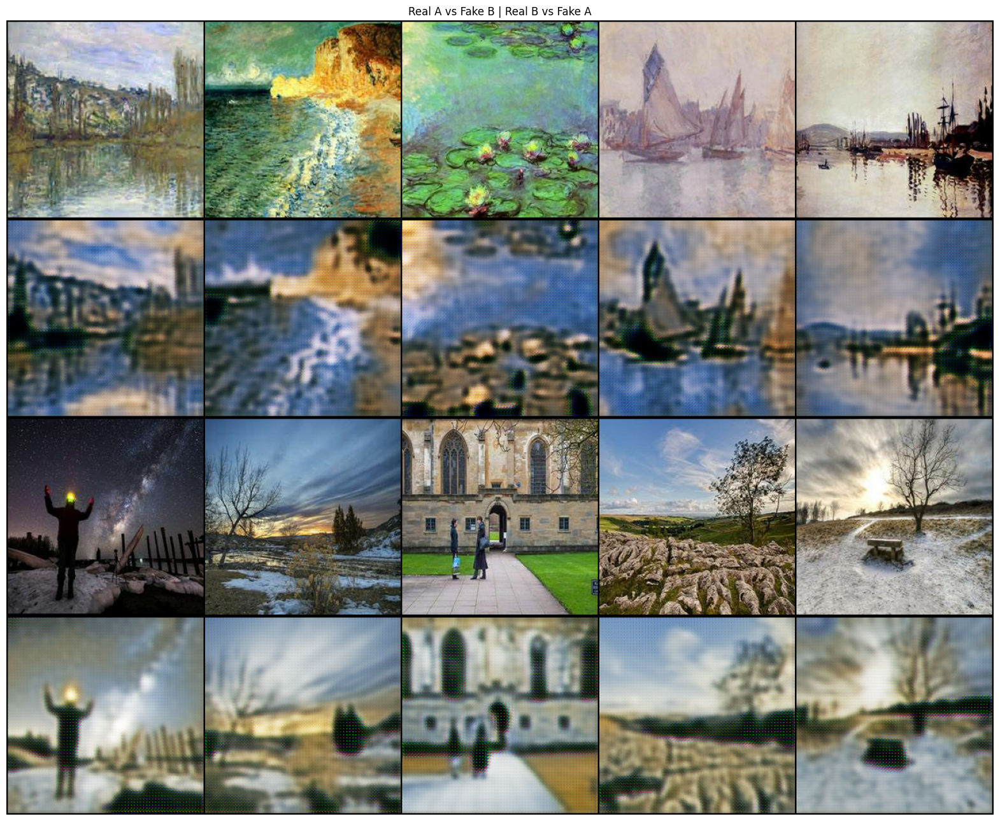

[Epoch 5/100] [Batch 200/250] [D loss : 0.217808] [G loss : 3.926694 - (adv : 0.323809, cycle : 0.243857, identity : 0.232863)]


  0%|          | 0/250 [00:00<?, ?it/s]

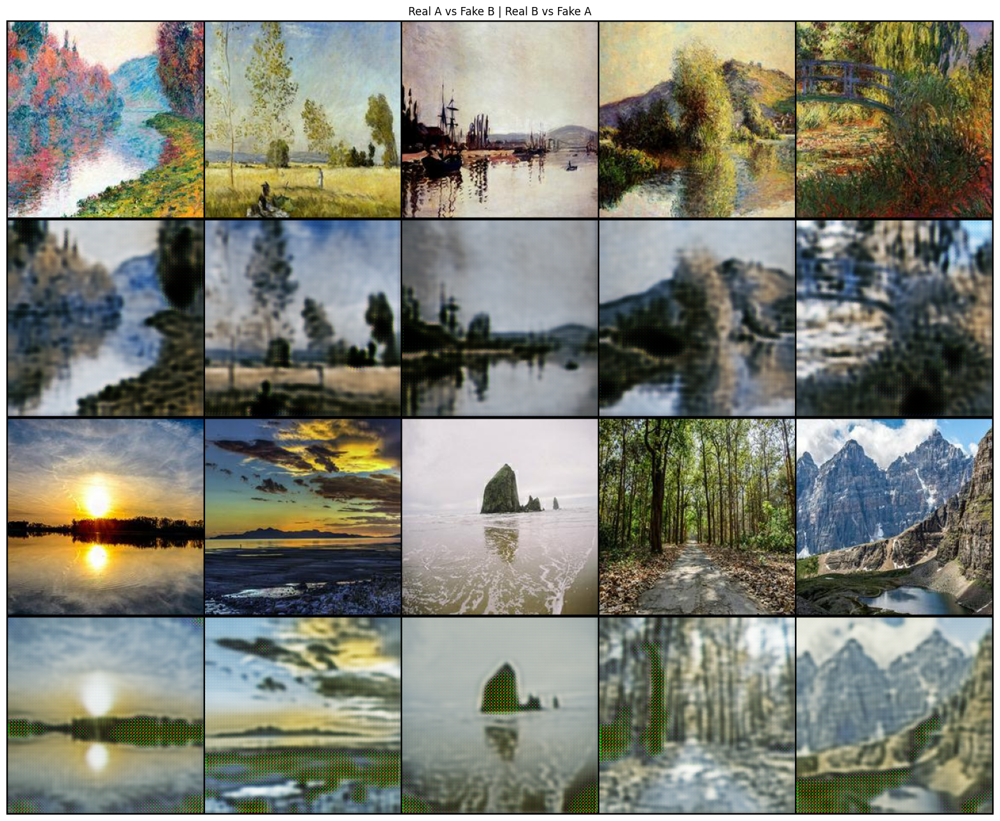

[Epoch 6/100] [Batch 200/250] [D loss : 0.182447] [G loss : 3.250324 - (adv : 0.350965, cycle : 0.193855, identity : 0.192161)]


  0%|          | 0/250 [00:00<?, ?it/s]

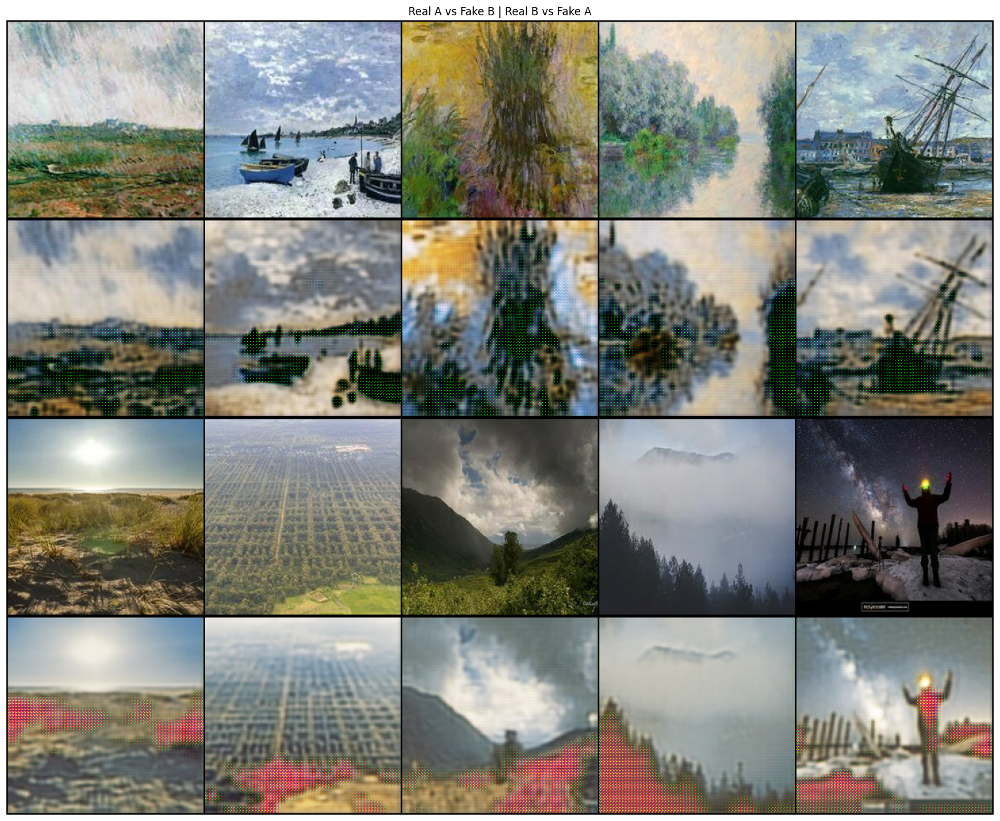

[Epoch 7/100] [Batch 200/250] [D loss : 0.132858] [G loss : 3.710380 - (adv : 0.459238, cycle : 0.225857, identity : 0.198514)]


  0%|          | 0/250 [00:00<?, ?it/s]

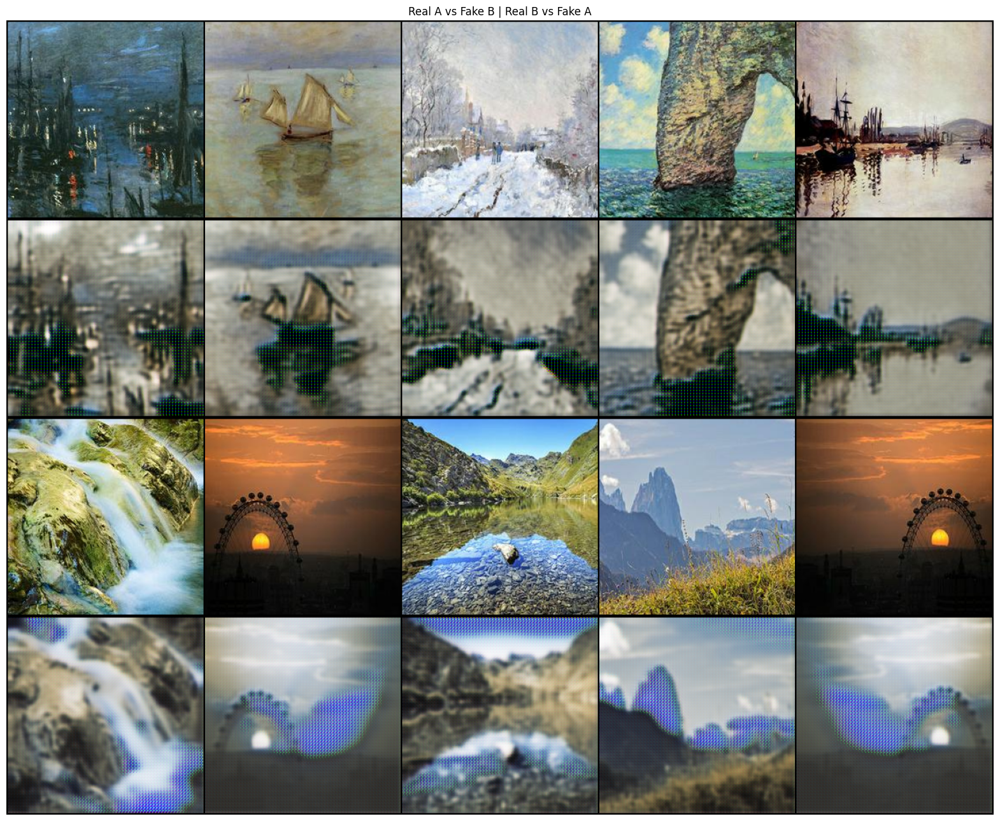

[Epoch 8/100] [Batch 200/250] [D loss : 0.057295] [G loss : 4.976458 - (adv : 0.736840, cycle : 0.287165, identity : 0.273593)]


  0%|          | 0/250 [00:00<?, ?it/s]

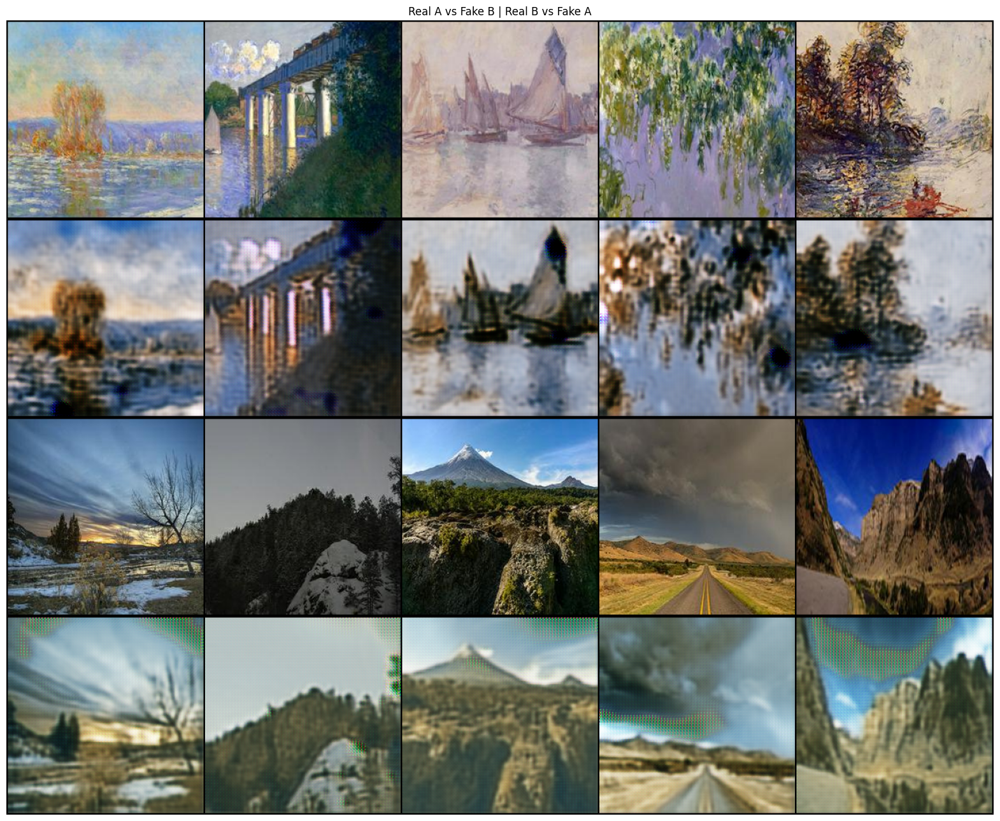

[Epoch 9/100] [Batch 200/250] [D loss : 0.228533] [G loss : 2.689182 - (adv : 0.314350, cycle : 0.161692, identity : 0.151583)]


  0%|          | 0/250 [00:00<?, ?it/s]

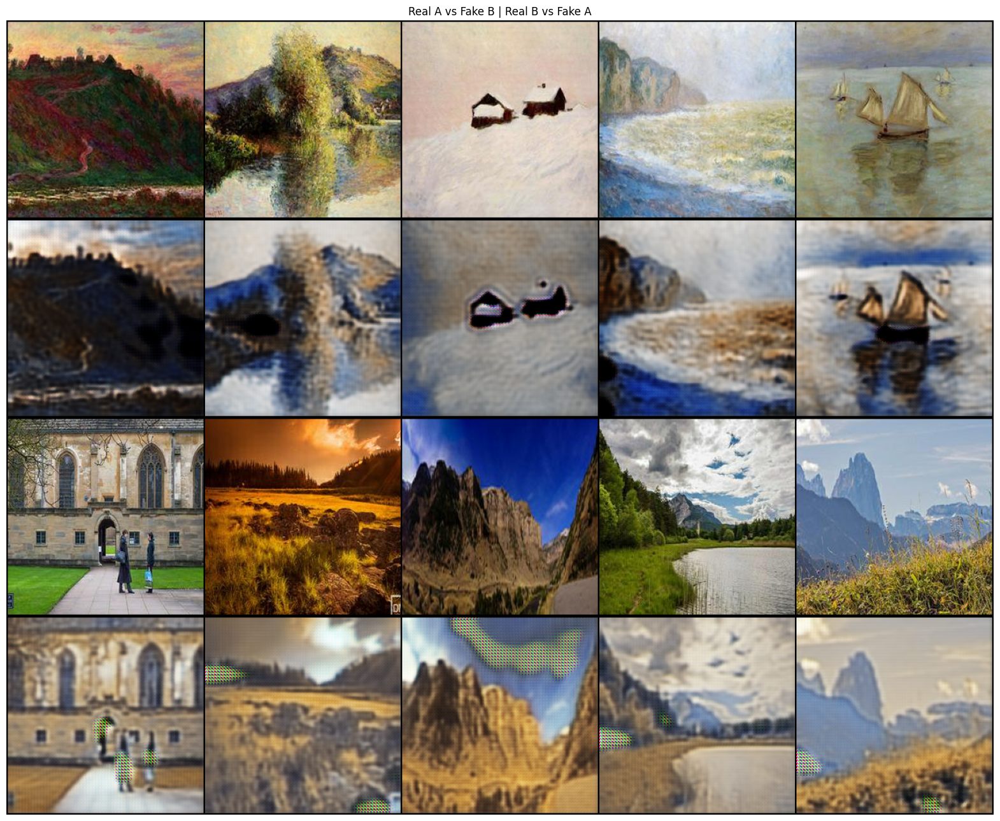

[Epoch 10/100] [Batch 200/250] [D loss : 0.192499] [G loss : 3.743251 - (adv : 0.460867, cycle : 0.231620, identity : 0.193238)]


  0%|          | 0/250 [00:00<?, ?it/s]

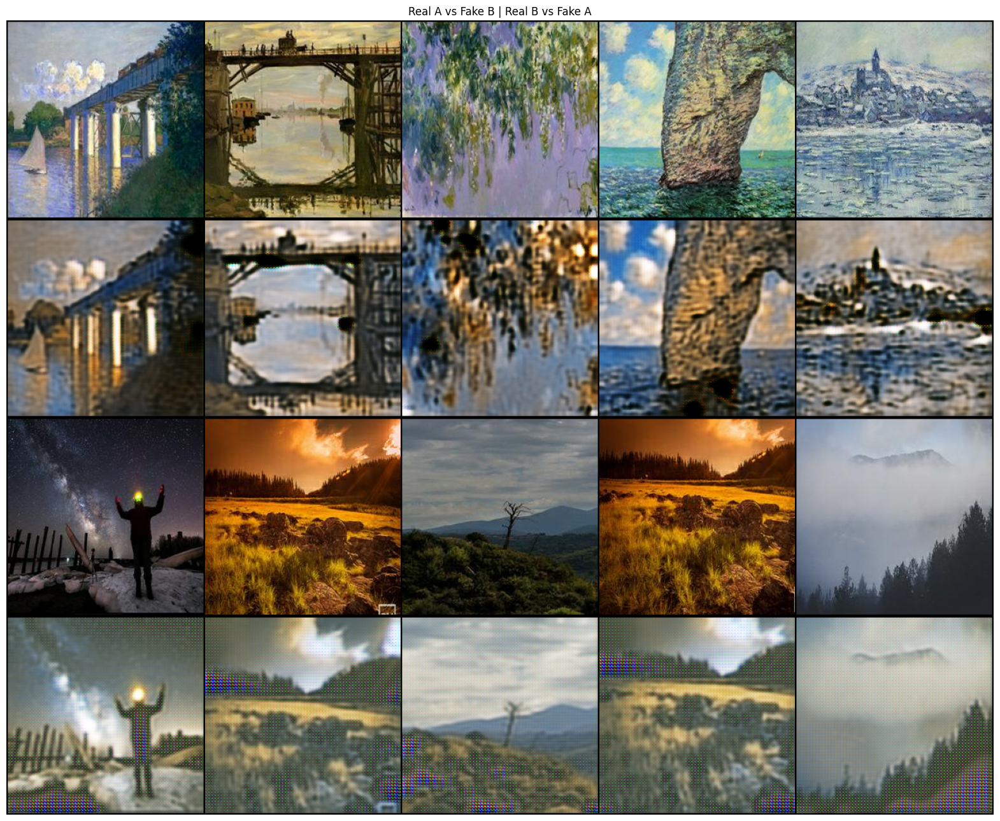

[Epoch 11/100] [Batch 200/250] [D loss : 0.268000] [G loss : 4.154185 - (adv : 0.337801, cycle : 0.275314, identity : 0.212649)]


  0%|          | 0/250 [00:00<?, ?it/s]

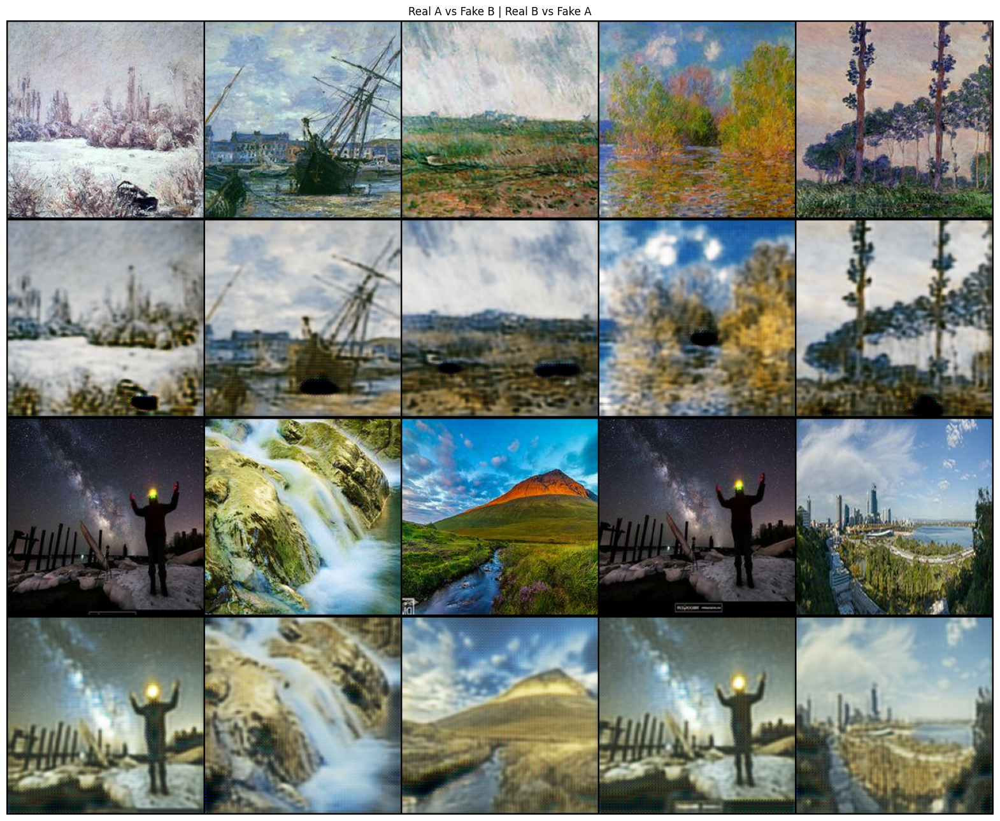

[Epoch 12/100] [Batch 200/250] [D loss : 0.175372] [G loss : 3.218707 - (adv : 0.428285, cycle : 0.190381, identity : 0.177322)]


  0%|          | 0/250 [00:00<?, ?it/s]

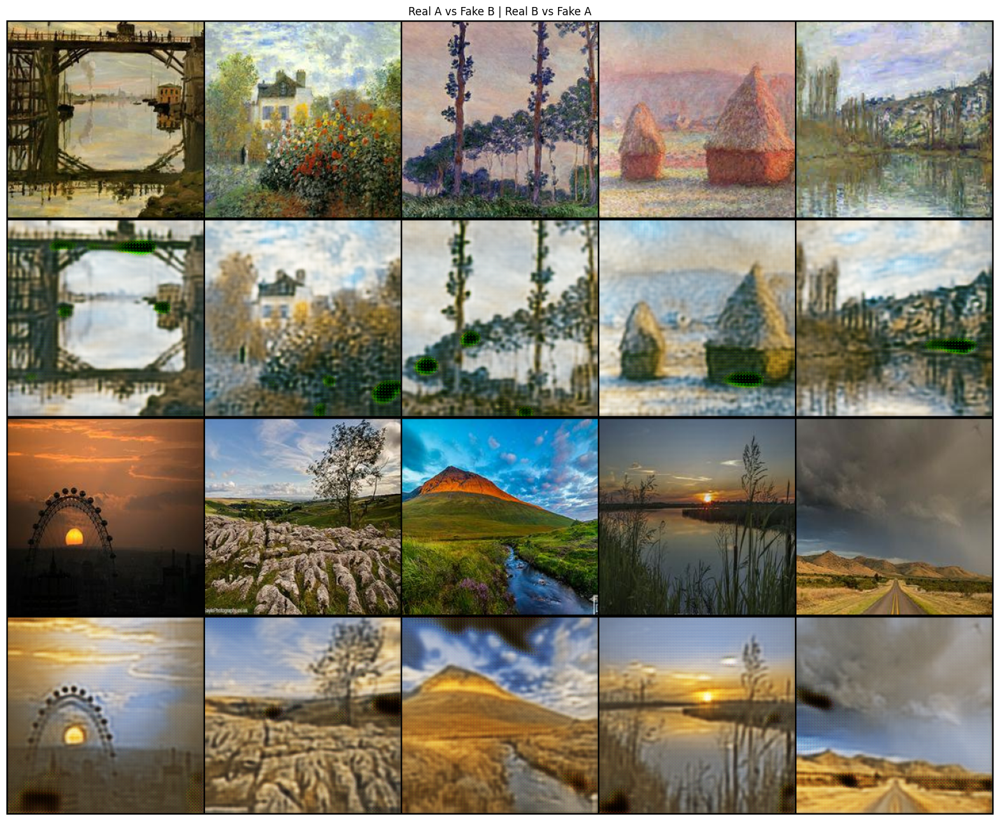

[Epoch 13/100] [Batch 200/250] [D loss : 0.242265] [G loss : 3.411469 - (adv : 0.457015, cycle : 0.182562, identity : 0.225768)]


  0%|          | 0/250 [00:00<?, ?it/s]

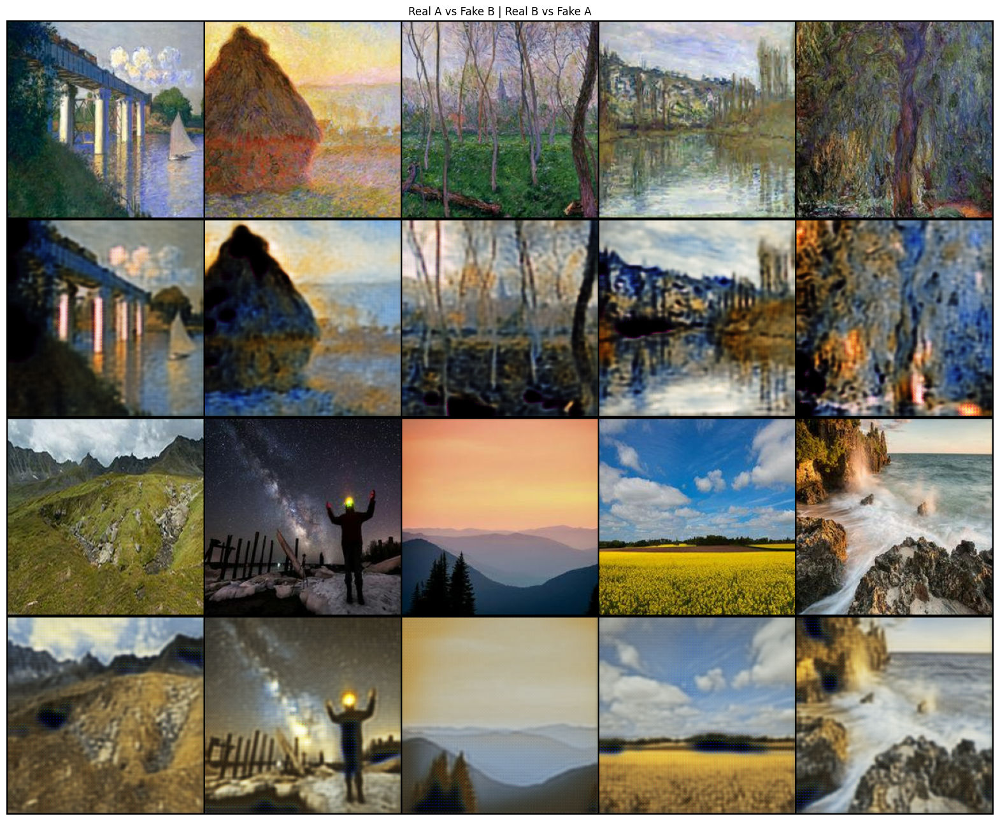

[Epoch 14/100] [Batch 200/250] [D loss : 0.193920] [G loss : 3.003093 - (adv : 0.361765, cycle : 0.175558, identity : 0.177149)]


  0%|          | 0/250 [00:00<?, ?it/s]

In [ ]:
n_epochs = 100
for epoch in range(epoch, n_epochs):
    for i, batch in enumerate(tqdm(dataloader)):

        # Set model input
        real_A = batch['A'].type(Tensor)
        real_B = batch['B'].type(Tensor)

        # Adversarial ground truths
        valid = Tensor(np.ones((real_A.size(0), 1, 32, 32))) # requires_grad = False. Default.
        fake = Tensor(np.zeros((real_A.size(0), 1, 32, 32))) # requires_grad = False. Default.

# -----------------
# Train Generators
# -----------------
        G_AB.train() # train mode
        G_BA.train() # train mode

        optimizer_G.zero_grad() # Integrated optimizer(G_AB, G_BA)

        # Identity Loss
        loss_id_A = criterion_identity(G_BA(real_A), real_A) # If you put A into a generator that creates A with B,
        loss_id_B = criterion_identity(G_AB(real_B), real_B) # then of course A must come out as it is.
                                                             # Taking this into consideration, add an identity loss that simply compares 'A and A' (or 'B and B').
        loss_identity = (loss_id_A + loss_id_B)/2

        # GAN Loss
        fake_B = G_AB(real_A) # fake_B is fake-photo that generated by real monet-drawing
        loss_GAN_AB = criterion_GAN(D_B(fake_B), valid) # tricking the 'fake-B' into 'real-B'
        fake_A = G_BA(real_B)
        loss_GAN_BA = criterion_GAN(D_A(fake_A), valid) # tricking the 'fake-A' into 'real-A'

        loss_GAN = (loss_GAN_AB + loss_GAN_BA)/2

        # Cycle Loss
        recov_A = G_BA(fake_B) # recov_A is fake-monet-drawing that generated by fake-photo
        loss_cycle_A = criterion_cycle(recov_A, real_A) # Reduces the difference between the restored image and the real image
        recov_B = G_AB(fake_A)
        loss_cycle_B = criterion_cycle(recov_B, real_B)

        loss_cycle = (loss_cycle_A + loss_cycle_B)/2

# ------> Total Loss
        loss_G = loss_GAN + (10.0*loss_cycle) + (5.0*loss_identity) # multiply suggested weight(default cycle loss weight : 10, default identity loss weight : 5)

        loss_G.backward()
        optimizer_G.step()

# -----------------
# Train Discriminator A
# -----------------
        optimizer_D_A.zero_grad()

        loss_real = criterion_GAN(D_A(real_A), valid) # train to discriminate real images as real
        loss_fake = criterion_GAN(D_A(fake_A.detach()), fake) # train to discriminate fake images as fake

        loss_D_A = (loss_real + loss_fake)/2

        loss_D_A.backward()
        optimizer_D_A.step()

# -----------------
# Train Discriminator B
# -----------------
        optimizer_D_B.zero_grad()

        loss_real = criterion_GAN(D_B(real_B), valid) # train to discriminate real images as real
        loss_fake = criterion_GAN(D_B(fake_B.detach()), fake) # train to discriminate fake images as fake

        loss_D_B = (loss_real + loss_fake)/2

        loss_D_B.backward()
        optimizer_D_B.step()

# ------> Total Loss
        loss_D = (loss_D_A + loss_D_B)/2

# -----------------
# Show Progress
# -----------------
        if (i+1) % 200 == 0:
            sample_images()
            print('[Epoch %d/%d] [Batch %d/%d] [D loss : %f] [G loss : %f - (adv : %f, cycle : %f, identity : %f)]'
                    %(epoch+1,n_epochs,       # [Epoch -]
                      i+1,len(dataloader),   # [Batch -]
                      loss_D.item(),       # [D loss -]
                      loss_G.item(),       # [G loss -]
                      loss_GAN.item(),     # [adv -]
                      loss_cycle.item(),   # [cycle -]
                      loss_identity.item(),# [identity -]
                     ))



### Дополнительно: модификации CycleGAN


### UVCGAN: UNet Vision Transformer cycle-consistent GAN for unpaired image-to-image translation (2022)

![UVCGAN](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/UVCGAN_v1.png)

Что нового:
1. Вместо ResNet в узком горлышке (bottleneck) используется pixel-wise vision transformer
2. Функция потерь дискриминатора со штрафом градиента. Штраф градиента, используемый в Вассерштейне плохо себя показал поэтому придумали свой.
3. Провели предварительное обучение генераторов UVCGAN. Разбили изображение на непересекающиеся фрагменты размером 32x32 и маскируем 40% фрагментов, устанавливая значения их пикселей в ноль. Генератор обучается предсказывать исходное немаскированное изображение, используя попиксельные потери L1. Рассмотрели два варианта предварительного обучения: a) на том же наборе данных, на котором будет выполняться последующий перевод изображений, и б) на наборе данных ImageNet


Реализация представлена здесь: https://github.com/LS4GAN/uvcgan

### Rethinking CycleGAN: Improving the Quality of GANs for Unpaired Image-to-Image Translation (2023)

![UVCGAN_V2](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/UVCGAN_v2.png)

Что нового:
1. Прокачали Vision Transfrormer. Дополнили последовательность дополнительным обучаемым маркером стиля S. Состояние маркера S на выходе трансформатора служит латентным стилем изображения. Для каждого конволюционного слоя декодирующей ветви U-сети генерируется определенный вектор стиля $s_i$ из S с помощью обучаемого линейного преобразования. Маркер стиля - похож на [CLS] в BERT.

2. Добавили дискриминатор с кешированием прямо в модель. 
![batch_head](https://raw.githubusercontent.com/sswt/dive2gai/main/unit2/data/batch_head.png)

3. Добавили новый лосс для улучшения согласованности между исходным изображением и сгенерированным изображением. Используют L1 лосс после того как уменьшили размер изображений до 32x32 пикселей.

4. UVCGAN и CycleGAN использовали устаревшие методы обучения GAN методы обучения. Поэтому переработали процедуру обучения, используя современные дополнения, включающие экспоненциальное усреднение весов генератора, спектральную нормализацию весов дискриминатора, опробовали неравные скорости обучения генератора и дискриминатора, а также заменили градиентный штраф (GP) улучшенной версией GP с нулевым центром (StyleGanV2).


Реализация представлена здесь: https://github.com/LS4GAN/uvcgan

## Упражнения

Попробуйте:

* Обучить WGAN на FashionMnist.
* Поэкспериментировать с гиперпараметрами при обучении.
* Поэкспериментировать с GP. Взять zero-centered GP, 0-GP, 1-GP.
* обучить cyclegan на другом датасете
* Обучить UVCGAN на исходных данных
* Добавить хеширование в CycleGan
